In [1017]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from joblib import Parallel, delayed
import time
from sklearn.linear_model import BayesianRidge
from sklearn.preprocessing import LabelEncoder

In [1018]:
df = pd.read_csv(r"C:\Users\hupadhya1\Documents\ML_DEMANATRA_Int\CMF_END_MED_Lon Run.csv")

In [1019]:
df['Month'] = pd.to_datetime(df['Month'])

In [1020]:
df = df.drop(columns=['Data Segmentation with Tuning Seg Plan'], errors='ignore')


In [1021]:
import pandas as pd

def convert_month_to_datetime(df):
    """Convert 'Month' column to datetime."""
    df['Month'] = pd.to_datetime(df['Month'], format='%m/%d/%Y', errors='coerce')
    if df['Month'].isna().sum() > 0:
        raise ValueError("Invalid dates found in the 'Month' column.")
    return df

def filter_by_time_frame(df, start_date, end_date):
    """Filter the data for the specified time frame."""
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    return df[(df['Month'] >= start_date) & (df['Month'] <= end_date)]

def fill_missing_values(df):
    """Fill missing values with 0."""
    df['Act Orders Final Rev'] = df['Act Orders Final Rev'].fillna(0)
    return df

def remove_items_with_zero_or_constant_values(df):
    """Remove items where all 'Act Orders Final Rev' values are zero or constant, considering all relevant columns."""
    group_cols = ['Country', 'Division', 'BUSINESS_SECTOR', 'FRANCHISE', 'BUSINESS_UNIT',
                  'IBP5_BRAND', 'IBP6_SUB_BRAND', 'IBP7_SEG_FAMILY', 'Item']
    
    item_stats = df.groupby(group_cols)['Act Orders Final Rev'].agg(['sum', 'nunique'])

    # Filter valid items where sum is not zero and has more than one unique value
    valid_items = item_stats[(item_stats['sum'] != 0) & (item_stats['nunique'] > 1)].index

    # Keep only the valid (Country, Division, ..., Item) combinations
    return df[df.set_index(group_cols).index.isin(valid_items)]

def filter_items_with_at_least_36_months(df):
    """Filter items with at least 36 months of data, considering all relevant columns."""
    group_cols = ['Country', 'Division', 'BUSINESS_SECTOR', 'FRANCHISE', 'BUSINESS_UNIT',
                  'IBP5_BRAND', 'IBP6_SUB_BRAND', 'IBP7_SEG_FAMILY', 'Item']

    item_counts = df.groupby(group_cols)['Month'].nunique()
    
    # Keep only items with at least 36 months of data
    valid_items = item_counts[item_counts >= 30].index

    return df[df.set_index(group_cols).index.isin(valid_items)]

def prepare_data(df, start_date, end_date):
    """Prepare the data by filtering, filling missing values, and removing items."""
    df = filter_by_time_frame(df, start_date, end_date)
    df = fill_missing_values(df)
    df = remove_items_with_zero_or_constant_values(df)
    df = filter_items_with_at_least_36_months(df)
    return df

# Prepare the data
dft_clean = prepare_data(df, start_date="2022-03-01", end_date="2025-02-01")

# Print results
print(dft_clean.head())
print("Number of unique item entries:", dft_clean[['Country', 'Division', 'BUSINESS_SECTOR', 'FRANCHISE', 'BUSINESS_UNIT', 
                                                   'IBP5_BRAND', 'IBP6_SUB_BRAND', 'IBP7_SEG_FAMILY', 'Item']].drop_duplicates().shape[0])


C:\Users\hupadhya1\AppData\Local\Temp\ipykernel_13768\1360507346.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



         Country        Division        BUSINESS_SECTOR  FRANCHISE  \
2  UNITED STATES  SUSTAINABILITY  MedSurg and Neurotech  Endoscopy   
3  UNITED STATES  SUSTAINABILITY  MedSurg and Neurotech  Endoscopy   
4  UNITED STATES  SUSTAINABILITY  MedSurg and Neurotech  Endoscopy   
5  UNITED STATES  SUSTAINABILITY  MedSurg and Neurotech  Endoscopy   
6  UNITED STATES  SUSTAINABILITY  MedSurg and Neurotech  Endoscopy   

              BUSINESS_UNIT               IBP5_BRAND       IBP6_SUB_BRAND  \
2  Sustainability Solutions  Advanced Energy Devices  Ultrasonic Scalpels   
3  Sustainability Solutions  Advanced Energy Devices  Ultrasonic Scalpels   
4  Sustainability Solutions  Advanced Energy Devices  Ultrasonic Scalpels   
5  Sustainability Solutions  Advanced Energy Devices  Ultrasonic Scalpels   
6  Sustainability Solutions  Advanced Energy Devices  Ultrasonic Scalpels   

                    IBP7_SEG_FAMILY    Item      Month  Act Orders Final Rev  \
2  Ethicon HARH Ultrasonic Scalpels 

In [1022]:
df_nixtla = dft_clean.copy()

In [1023]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
# Generate a unique identifier for each item considering the combination of all categorical columns
df_nixtla["unique_id"] = df_nixtla['Item'].astype(str) + "_" + \
                          df_nixtla['Country'].astype(str) + "_" + \
                          df_nixtla['Division'].astype(str) + "_" + \
                          df_nixtla['BUSINESS_SECTOR'].astype(str) + "_" + \
                          df_nixtla['FRANCHISE'].astype(str) + "_" + \
                          df_nixtla['BUSINESS_UNIT'].astype(str) + "_" + \
                          df_nixtla['IBP5_BRAND'].astype(str) + "_" + \
                          df_nixtla['IBP6_SUB_BRAND'].astype(str) + "_" + \
                          df_nixtla['IBP7_SEG_FAMILY'].astype(str)

# Label encode the newly created item_key
df_nixtla["unique_id"] = label_encoder.fit_transform(df_nixtla["unique_id"])


In [1024]:
df_nixtla['unique_id'].nunique()

1860

In [1025]:
df_n = df_nixtla[['unique_id','Month','Act Orders Final Rev']]

In [1026]:
df_n = df_n.rename(columns={"Month": "ds", "Act Orders Final Rev": "y"})

In [1027]:
Y_train_df = df_n[df_n.ds<='2024-08-01'] 
Y_test_df = df_n[df_n.ds>'2024-08-01']

In [1028]:
leading_zero_sales = (
    df_n.groupby("unique_id")
                     .agg({'y': lambda df: df.eq(0).cummin().sum()})
                     .rename(columns={'y': "leading_zero_sales"})
)

for i in [12,13,14,15]:
    threshold = i 
    n_uids = len(leading_zero_sales.query(f"leading_zero_sales > {threshold}"))
    print(f"There are {n_uids} unique_ids with more more than {threshold} leading zeros")

There are 546 unique_ids with more more than 12 leading zeros
There are 537 unique_ids with more more than 13 leading zeros
There are 522 unique_ids with more more than 14 leading zeros
There are 503 unique_ids with more more than 15 leading zeros


In [1029]:
_threshold = 12
uids = (
    leading_zero_sales.query(f"leading_zero_sales > {_threshold}")
                      .index
                      .to_list()
)

with_leading_zero_sales_df = df_n.query("unique_id in @uids")

In [1030]:
with_leading_zero_sales_df['unique_id'].nunique()

546

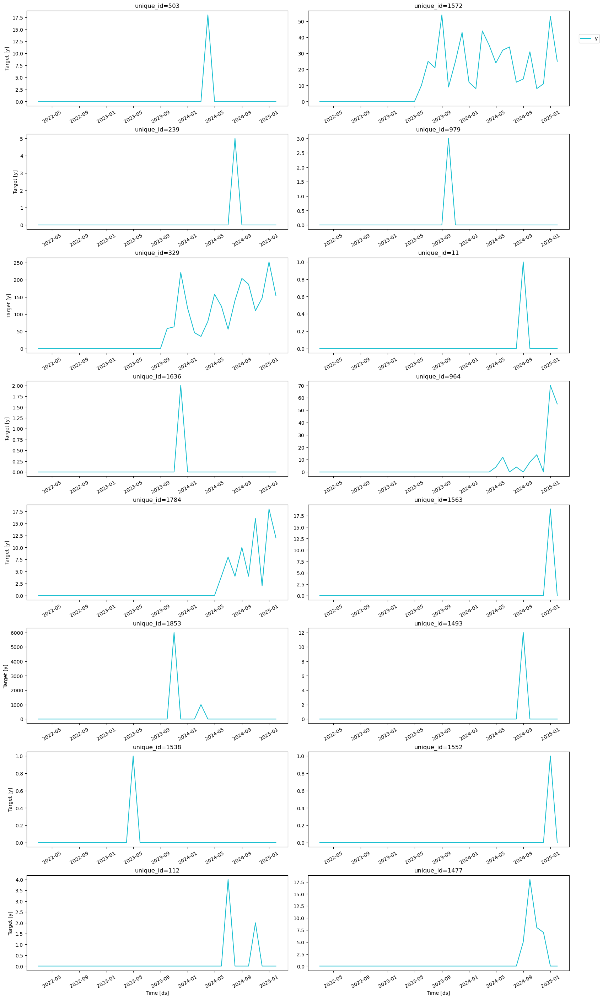

In [1031]:
plot_series(
    df=with_leading_zero_sales_df,
    plot_random=True,
    engine="matplotlib",
    max_ids=16,
    seed=None,
)

In [1032]:
trailing_zero_sales = (
    df_n.sort_values(by=["unique_id", "ds"], ascending=[True, False])
             .groupby("unique_id")
             .agg({'y': lambda df: df.eq(0).cummin().sum()})
             .rename(columns={'y': "trailing_zero_sales"})
)

for i in range(1,13):
    n_zeros = i
    n_uids = len(trailing_zero_sales.query(f"trailing_zero_sales > {n_zeros}"))
    print(f"There are {n_uids} unique_ids with more more than {n_zeros} trailing zeros")

There are 349 unique_ids with more more than 1 trailing zeros
There are 304 unique_ids with more more than 2 trailing zeros
There are 272 unique_ids with more more than 3 trailing zeros
There are 240 unique_ids with more more than 4 trailing zeros
There are 216 unique_ids with more more than 5 trailing zeros
There are 201 unique_ids with more more than 6 trailing zeros
There are 172 unique_ids with more more than 7 trailing zeros
There are 152 unique_ids with more more than 8 trailing zeros
There are 122 unique_ids with more more than 9 trailing zeros
There are 117 unique_ids with more more than 10 trailing zeros
There are 98 unique_ids with more more than 11 trailing zeros
There are 90 unique_ids with more more than 12 trailing zeros


In [1033]:
min_threshold, max_threshold = 12,36
uids = (
    trailing_zero_sales.query(f"{min_threshold} < trailing_zero_sales < {max_threshold}")
                       .index
                       .to_list()
)

with_trailing_zero_sales_df = df_n.query("unique_id in @uids")

In [1034]:
with_trailing_zero_sales_df['unique_id'].nunique()

90

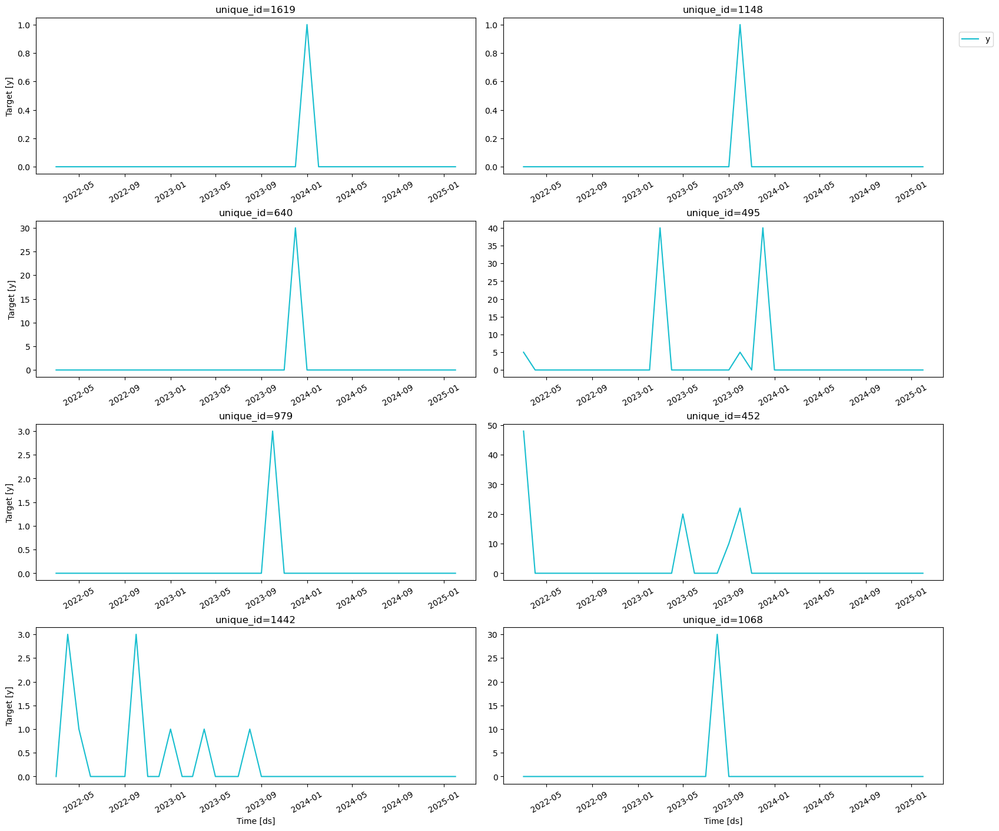

In [1035]:
plot_series(
    df=with_trailing_zero_sales_df,
    plot_random=True,
    engine="matplotlib",
    seed=None,
)

In [1036]:
min_threshold, max_threshold = 12, 36

# Get unique_id values to drop based on trailing_zero_sales
uids_trailing = (
    trailing_zero_sales.query(f"{min_threshold} < trailing_zero_sales < {max_threshold}")
                       .index
                       .to_list()
)

# Get unique_id values to drop based on leading_zero_sales
_threshold = 12
uids_leading = (
    leading_zero_sales.query(f"leading_zero_sales > {_threshold}")
                      .index
                      .to_list()
)

# Combine both lists
uids_to_drop = set(uids_trailing + uids_leading)

# Drop them from df_n
df_n_filtered = df_n[~df_n["unique_id"].isin(uids_to_drop)]


In [1037]:
df_n_filtered['unique_id'].nunique()

1296

In [1038]:
Y_train_df = df_n_filtered[df_n_filtered.ds<='2024-08-01'] 
Y_test_df = df_n_filtered[df_n_filtered.ds>'2024-08-01']

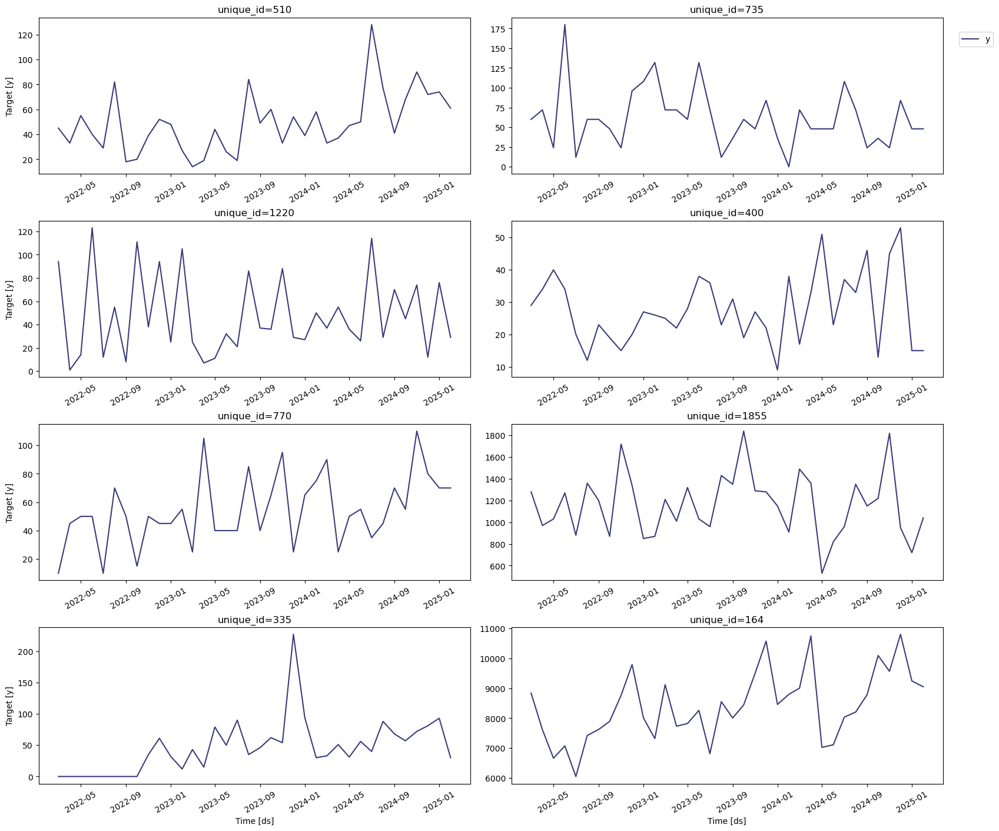

In [1039]:
from statsforecast import StatsForecast

StatsForecast.plot(df_n_filtered)

In [1040]:
import lightgbm as lgb
from mlforecast.lag_transforms import ExpandingMean, RollingMean,ExponentiallyWeightedMean,RollingStd,RollingMin, RollingMax, RollingQuantile,SeasonalRollingMean, SeasonalRollingStd, SeasonalRollingMin, SeasonalRollingMax, SeasonalRollingQuantile
from mlforecast import MLForecast
from mlforecast.target_transforms import Differences
#from mlforecast.feature_engineering import fourier


In [1041]:
from lightgbm import LGBMRegressor
from sklearn.linear_model import LinearRegression
# XGBRegressor: A gradient boosting regressor model from the XGBoost library
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor
# LinearRegression: A simple linear regression model from the scikit-learn library
from sklearn.linear_model import LinearRegression

In [1042]:
models = [#LinearRegression(),  # Simple linear regression model
    LGBMRegressor(verbosity=-1),
    #lgb.LGBMRegressor(verbosity=-1),  # LightGBM regressor with verbosity turned off
    XGBRegressor(),  # XGBoost regressor with default parameters
    RandomForestRegressor(random_state=0),  # Random Forest regressor with fixed random state for reproducibility
]
fcst = MLForecast(
    models=models,  # List of models to be used for forecasting
    freq='MS',  # Monthly frequency, starting at the beginning of each month
    lags=[1,3,4,6,12],  # Lag features: values from 1, 3, 5, 7, and 12 time steps ago
    lag_transforms={
        1: [  # Transformations applied to lag 1
            RollingMean(window_size=3),  # Rolling mean with a window of 3 time steps
            RollingStd(window_size=3),  # Rolling standard deviation with a window of 3 time steps
            RollingMin(window_size=3),  # Rolling minimum with a window of 3 time steps
            RollingMax(window_size=3),  # Rolling maximum with a window of 3 time steps
            RollingQuantile(p=0.5, window_size=3),  # Rolling median (50th percentile) with a window of 3 time steps
            ExpandingMean(),  # Expanding mean (mean of all previous values)
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=1)
        ],
        6:[  # Transformations applied to lag 6
            RollingMean(window_size=6),  # Rolling mean with a window of 6 time steps
            RollingStd(window_size=6),  # Rolling standard deviation with a window of 6 time steps
            RollingMin(window_size=6),  # Rolling minimum with a window of 6 time steps
            RollingMax(window_size=6),  # Rolling maximum with a window of 6 time steps
            RollingQuantile(p=0.5, window_size=6),  # Rolling median (50th percentile) with a window of 6 time steps
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=6)
        ],
        12: [  # Transformations applied to lag 12 (likely for yearly seasonality)
            RollingMean( window_size=12),  # Seasonal rolling mean with 12-month seasonality and 3-month window
            RollingStd(window_size=12),  # Seasonal rolling standard deviation with 12-month seasonality and 3-month window
            RollingMin(window_size=12),  # Seasonal rolling minimum with 12-month seasonality and 3-month window
            RollingMax(window_size=12),  # Seasonal rolling maximum with 12-month seasonality and 3-month window
            RollingQuantile(p=0.5,window_size=12),  # Seasonal rolling median with 12-month seasonality and 3-month window
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=3)
        ]
    },
    date_features=['year', 'month', 'quarter'],  # Extract year, month, and quarter from the date as features
    target_transforms=[Differences([1])])  # Apply first-order differencing to the target variable

In [1043]:
processed_df=fcst.preprocess(Y_train_df)

In [1044]:
fcst.fit(Y_train_df)

MLForecast(models=[LGBMRegressor, XGBRegressor, RandomForestRegressor], freq=MS, lag_features=['lag1', 'lag3', 'lag4', 'lag6', 'lag12', 'rolling_mean_lag1_window_size3', 'rolling_std_lag1_window_size3', 'rolling_min_lag1_window_size3', 'rolling_max_lag1_window_size3', 'rolling_quantile_lag1_p0.5_window_size3', 'expanding_mean_lag1', 'exponentially_weighted_mean_lag1_alpha0.5', 'exponentially_weighted_mean_lag1_alpha0.3', 'rolling_mean_lag6_window_size6', 'rolling_std_lag6_window_size6', 'rolling_min_lag6_window_size6', 'rolling_max_lag6_window_size6', 'rolling_quantile_lag6_p0.5_window_size6', 'exponentially_weighted_mean_lag6_alpha0.5', 'exponentially_weighted_mean_lag6_alpha0.3', 'rolling_mean_lag12_window_size12', 'rolling_std_lag12_window_size12', 'rolling_min_lag12_window_size12', 'rolling_max_lag12_window_size12', 'rolling_quantile_lag12_p0.5_window_size12', 'exponentially_weighted_mean_lag12_alpha0.5', 'exponentially_weighted_mean_lag12_alpha0.3'], date_features=['year', 'month'

In [1045]:
preds = fcst.predict(65)
preds

,unique_id,ds,LGBMRegressor,XGBRegressor,RandomForestRegressor
0,0,2024-09-01,138.320773,146.370384,241.81
1,0,2024-10-01,177.407758,221.999092,228.99
2,0,2024-11-01,179.658054,229.071626,164.56
3,0,2024-12-01,149.908339,323.107805,288.83
4,0,2025-01-01,162.717418,245.967035,274.55
...,...,...,...,...,...
84235,1859,2029-09-01,607.858877,805.550171,772.33
84236,1859,2029-10-01,610.934591,804.432550,865.67
84237,1859,2029-11-01,614.010305,810.647843,798.58
84238,1859,2029-12-01,617.086020,809.530222,859.83


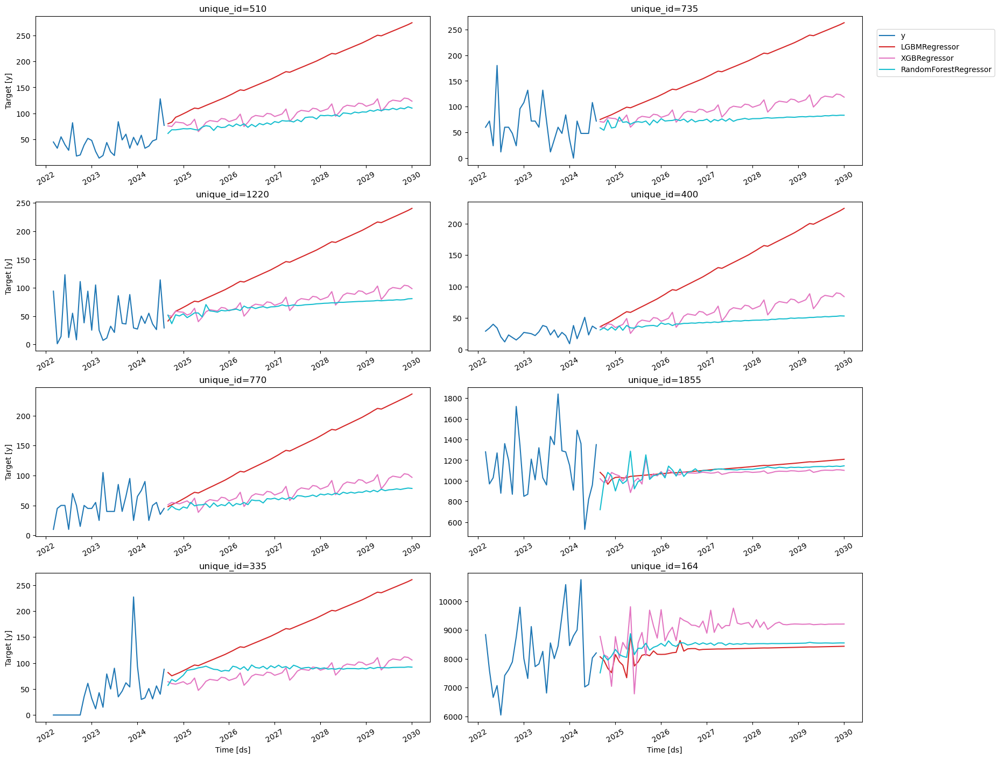

In [1046]:
fig = plot_series(Y_train_df, preds)
fig

In [299]:
lgb_params = {
    'verbosity': -1,
    'num_leaves': 512,
}

fcst = MLForecast(
    models={
        'avg': lgb.LGBMRegressor(**lgb_params),
        'q75': lgb.LGBMRegressor(**lgb_params, objective='quantile', alpha=0.75),
        'q25': lgb.LGBMRegressor(**lgb_params, objective='quantile', alpha=0.25),
    },
    freq='MS',
    target_transforms=[Differences([1])],
    lags=[1,2,3,4,6,12],
    lag_transforms={
        1: [ExpandingMean()],
        12: [RollingMean(window_size=6),],
    },
    date_features=['month','quarter','year'],
)
fcst.fit(Y_train_df)

MLForecast(models=[avg, q75, q25], freq=MS, lag_features=['lag1', 'lag2', 'lag3', 'lag4', 'lag6', 'lag12', 'expanding_mean_lag1', 'rolling_mean_lag12_window_size6'], date_features=['month', 'quarter', 'year'], num_threads=1)

In [300]:
preds = fcst.predict(65)
preds

,unique_id,ds,avg,q75,q25
0,0,2024-09-01,245.320161,320.939625,155.627035
1,0,2024-10-01,213.540516,336.617721,108.086146
2,0,2024-11-01,195.423848,291.769060,91.888869
3,0,2024-12-01,509.494590,445.405031,194.862611
4,0,2025-01-01,143.991562,360.425373,-0.570550
...,...,...,...,...,...
120895,1859,2029-09-01,896.049212,1339.954626,-50.905571
120896,1859,2029-10-01,908.038522,1396.348065,-50.872625
120897,1859,2029-11-01,997.070203,1399.515455,-52.834622
120898,1859,2029-12-01,968.710686,1439.505486,-51.968244


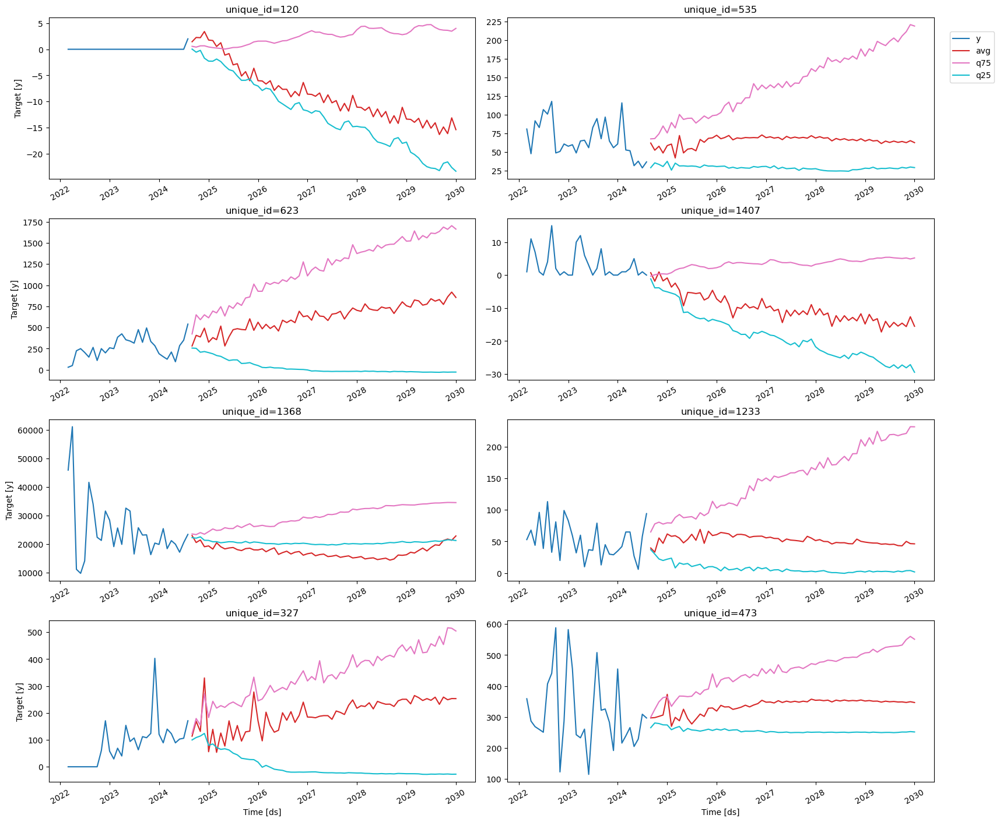

In [301]:
fig = plot_series(Y_train_df, preds)
fig

In [304]:
lgb_params = {
    'verbosity': -1,
    'num_leaves': 512,
}



fcst = MLForecast(
    models={
        'avg': lgb.LGBMRegressor(**lgb_params),
        'q75': lgb.LGBMRegressor(**lgb_params, objective='quantile', alpha=0.75),
        'q25': lgb.LGBMRegressor(**lgb_params, objective='quantile', alpha=0.25),
    },  # List of models to be used for forecasting
    freq='MS',
    target_transforms=[Differences([1])],
    lags=[1,3,4,6,12],  # Lag features: values from 1, 3, 5, 7, and 12 time steps ago
    lag_transforms={
        1: [ExpandingMean(),RollingStd(window_size=3),RollingMean(window_size=3),RollingMin(window_size=3),
            RollingMax(window_size=3),RollingQuantile(p=0.5, window_size=3),],
        6:[  # Transformations applied to lag 6
            RollingMean(window_size=6),  # Rolling mean with a window of 6 time steps
            RollingStd(window_size=6),  # Rolling standard deviation with a window of 6 time steps
            RollingMin(window_size=6),  # Rolling minimum with a window of 6 time steps
            RollingMax(window_size=6),  # Rolling maximum with a window of 6 time steps
            RollingQuantile(p=0.5, window_size=6),],  # Rolling median (50th percentile) with a window of 6 time steps        
        
        12: [ExpandingMean(),RollingStd(window_size=6),RollingMean(window_size=6),RollingMin(window_size=6),
            RollingMax(window_size=6),RollingQuantile(p=0.5, window_size=6),]
    },
    date_features=['year', 'month', 'quarter'],  # Extract year, month, and quarter from the date as features
)  
fcst.fit(Y_train_df)

MLForecast(models=[avg, q75, q25], freq=MS, lag_features=['lag1', 'lag3', 'lag4', 'lag6', 'lag12', 'expanding_mean_lag1', 'rolling_std_lag1_window_size3', 'rolling_mean_lag1_window_size3', 'rolling_min_lag1_window_size3', 'rolling_max_lag1_window_size3', 'rolling_quantile_lag1_p0.5_window_size3', 'rolling_mean_lag6_window_size6', 'rolling_std_lag6_window_size6', 'rolling_min_lag6_window_size6', 'rolling_max_lag6_window_size6', 'rolling_quantile_lag6_p0.5_window_size6', 'expanding_mean_lag12', 'rolling_std_lag12_window_size6', 'rolling_mean_lag12_window_size6', 'rolling_min_lag12_window_size6', 'rolling_max_lag12_window_size6', 'rolling_quantile_lag12_p0.5_window_size6'], date_features=['year', 'month', 'quarter'], num_threads=1)

In [305]:
preds = fcst.predict(65)
preds

,unique_id,ds,avg,q75,q25
0,0,2024-09-01,171.449189,185.418956,61.336941
1,0,2024-10-01,190.134171,177.851944,89.806595
2,0,2024-11-01,83.332981,188.747352,66.025414
3,0,2024-12-01,267.389281,294.468480,106.258544
4,0,2025-01-01,187.005984,233.715986,48.197287
...,...,...,...,...,...
120895,1859,2029-09-01,442.804279,1178.987638,-4.636381
120896,1859,2029-10-01,430.841129,1245.675187,-4.604093
120897,1859,2029-11-01,457.468893,1226.441030,-5.406582
120898,1859,2029-12-01,442.041256,1266.668534,-5.374293


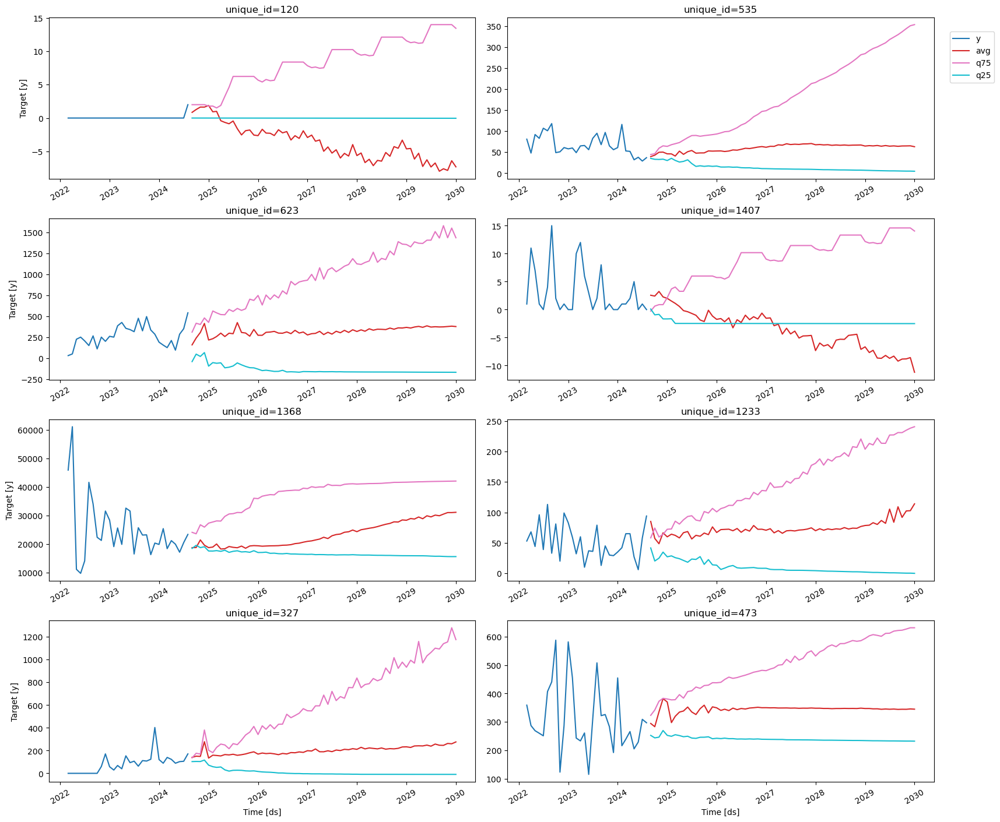

In [306]:
fig = plot_series(Y_train_df, preds)
fig

In [ ]:
#Defining a function to calculate the error metrics
def calculate_error_metrics(actual_values, predicted_values):
    actual_values = np.array(actual_values)
    predicted_values = np.array(predicted_values)

    metrics_dict = {
        'MAE': np.mean(np.abs(actual_values - predicted_values)),  # Mean Absolute Error
        'RMSE': np.sqrt(np.mean((actual_values - predicted_values)**2)),  # Root Mean Square Error
        'MAPE': np.mean(np.abs((actual_values - predicted_values) / actual_values)) * 100}  # Mean Absolute Percentage Error

    result_df = pd.DataFrame(list(metrics_dict.items()), columns=['Metric', 'Value'])
    return result_df

# Extracting actual values from the result DataFrame
actuals = fcst_result['y']

# Dictionary to store error metrics for each model
error_metrics_dict = {}

# Calculating error metrics for each model's predictions
for col in fcst_result.columns[1:]:  # Iterating through prediction columns (skipping the first column which is likely the actual values)
    predicted_values = fcst_result[col]
    error_metrics_dict[col] = calculate_error_metrics(actuals, predicted_values)['Value'].values  # Extracting 'Value' column

# Creating a DataFrame from the error metrics dictionary
error_metrics_df = pd.DataFrame(error_metrics_dict).T.reset_index()
error_metrics_df.columns = ['Model', 'MAE', 'RMSE', 'MAPE']  # Renaming columns for clarity
print(error_metrics_df)  

In [230]:
from utilsforecast.plotting import plot_series

In [231]:
fig = plot_series(Y_train_df, preds, max_insample_length=33)

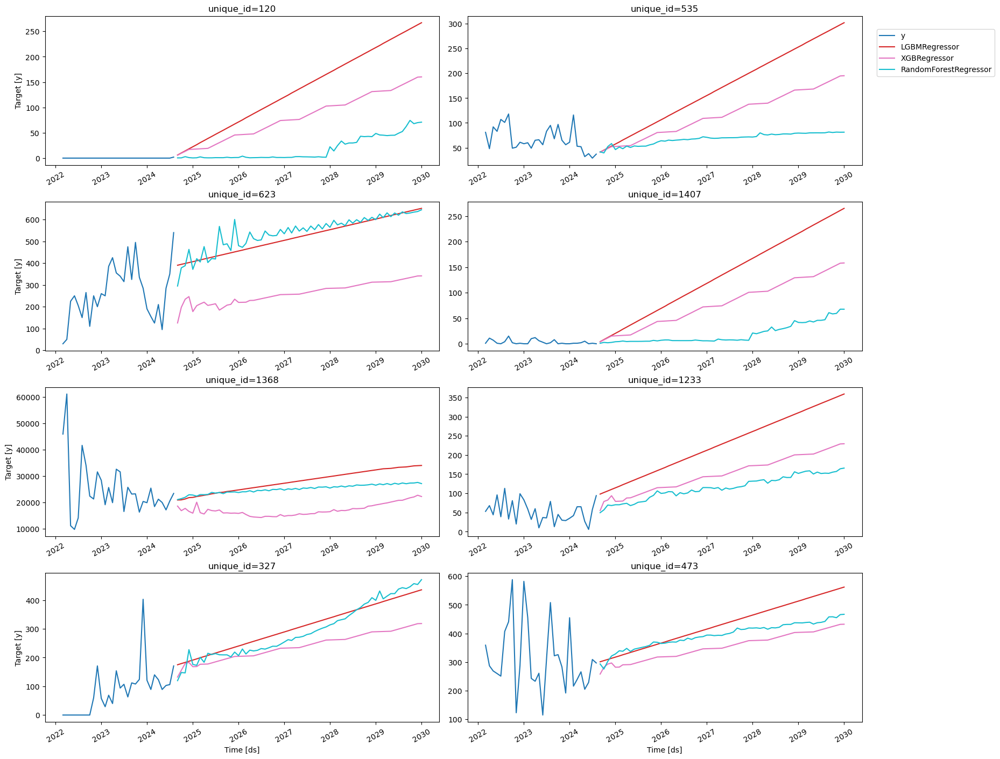

In [232]:
fig

In [311]:
fcst = MLForecast(
    models=lgb.LGBMRegressor(**lgb_params),
    freq='MS',
    target_transforms=[Differences([1])],
    lags=[1,2,3,4,6,7,8,12,18,24],  # Lag features: values from 1, 3, 5, 7, and 12 time steps ago
    lag_transforms={
        1: [  # Transformations applied to lag 1
            RollingMean(window_size=3),  # Rolling mean with a window of 3 time steps
            RollingStd(window_size=3),  # Rolling standard deviation with a window of 3 time steps
            RollingMin(window_size=3),  # Rolling minimum with a window of 3 time steps
            RollingMax(window_size=3),  # Rolling maximum with a window of 3 time steps
            RollingQuantile(p=0.5, window_size=3),  # Rolling median (50th percentile) with a window of 3 time steps
            ExpandingMean(),  # Expanding mean (mean of all previous values)
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=1)
        ],
        6:[  # Transformations applied to lag 6
            RollingMean(window_size=6),  # Rolling mean with a window of 6 time steps
            RollingStd(window_size=6),  # Rolling standard deviation with a window of 6 time steps
            RollingMin(window_size=6),  # Rolling minimum with a window of 6 time steps
            RollingMax(window_size=6),  # Rolling maximum with a window of 6 time steps
            RollingQuantile(p=0.5, window_size=6),  # Rolling median (50th percentile) with a window of 6 time steps
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=6)
        ],
        12: [  # Transformations applied to lag 12 (likely for yearly seasonality)
            RollingMean( window_size=12),  # Seasonal rolling mean with 12-month seasonality and 3-month window
            RollingStd(window_size=12),  # Seasonal rolling standard deviation with 12-month seasonality and 3-month window
            RollingMin(window_size=12),  # Seasonal rolling minimum with 12-month seasonality and 3-month window
            RollingMax(window_size=12),  # Seasonal rolling maximum with 12-month seasonality and 3-month window
            RollingQuantile(p=0.5,window_size=12),  # Seasonal rolling median with 12-month seasonality and 3-month window
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=3)
        ]
    },
    date_features=['year', 'month', 'quarter'],  # Extract year, month, and quarter from the date as features
)
cv_result = fcst.cross_validation(
    df_n,
    n_windows=1,  # number of models to train/splits to perform
    h=6,  # length of the validation set in each window
)
cv_result

,unique_id,ds,cutoff,y,LGBMRegressor
0,0,2024-09-01,2024-08-01,168.0,67.941582
1,0,2024-10-01,2024-08-01,96.0,147.764581
2,0,2024-11-01,2024-08-01,252.0,167.099700
3,0,2024-12-01,2024-08-01,432.0,172.365938
4,0,2025-01-01,2024-08-01,276.0,30.228689
...,...,...,...,...,...
11155,1859,2024-10-01,2024-08-01,100.0,634.201757
11156,1859,2024-11-01,2024-08-01,130.0,403.697852
11157,1859,2024-12-01,2024-08-01,570.0,485.699131
11158,1859,2025-01-01,2024-08-01,320.0,497.718225


In [312]:
fig = plot_series(forecasts_df=cv_result.drop(columns='cutoff'))

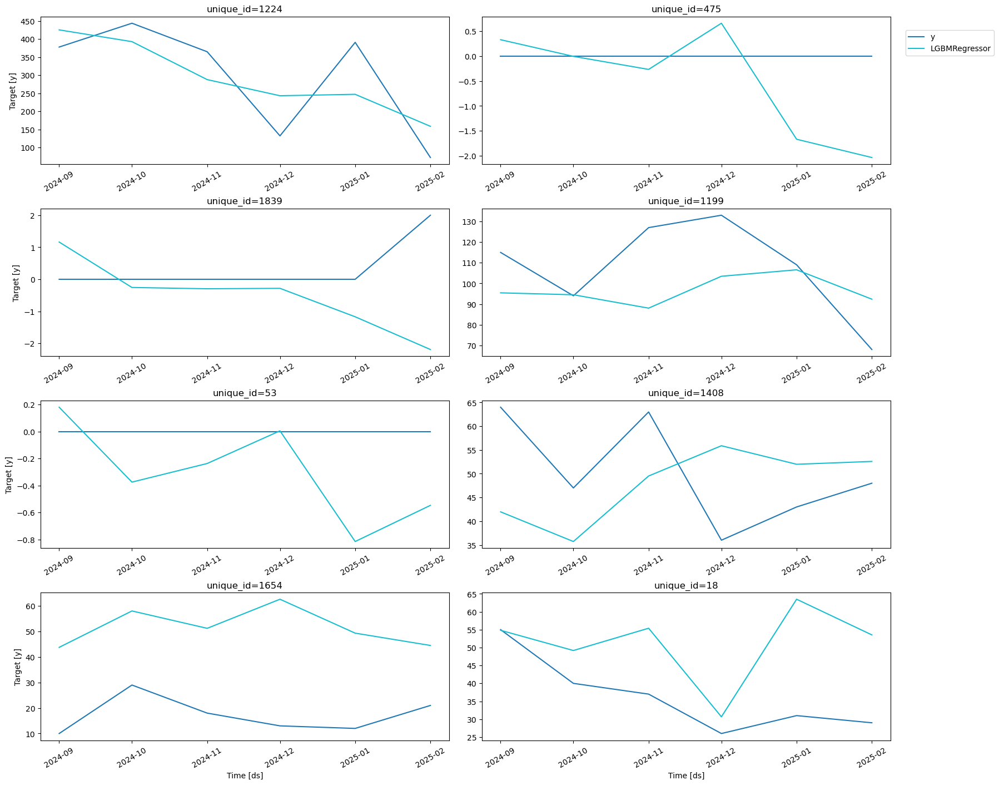

In [313]:
fig

In [181]:
from utilsforecast.losses import rmse

In [182]:
def evaluate_cv(df):
    return rmse(df, models=['LGBMRegressor'], id_col='cutoff').set_index('cutoff')

split_rmse = evaluate_cv(cv_result)
split_rmse

,LGBMRegressor
cutoff,
2024-08-01,16529.00623


In [183]:
split_rmse.mean()

LGBMRegressor    16529.00623
dtype: float64

In [184]:
from mlforecast.lag_transforms import ExponentiallyWeightedMean

In [433]:
fcst = MLForecast(
    models=[LGBMRegressor(verbosity=-1),
    #lgb.LGBMRegressor(verbosity=-1),  # LightGBM regressor with verbosity turned off
    XGBRegressor(),  # XGBoost regressor with default parameters
    RandomForestRegressor(random_state=0)],
    freq='MS',
    target_transforms=[Differences([1])],
    lags=[1,3,4,6,7,8,12,18,24],  # Lag features: values from 1, 3, 5, 7, and 12 time steps ago
    lag_transforms={
        1: [  # Transformations applied to lag 1
            RollingMean(window_size=3),  # Rolling mean with a window of 3 time steps
            RollingStd(window_size=3),  # Rolling standard deviation with a window of 3 time steps
            RollingMin(window_size=3),  # Rolling minimum with a window of 3 time steps
            RollingMax(window_size=3),  # Rolling maximum with a window of 3 time steps
            RollingQuantile(p=0.5, window_size=3),  # Rolling median (50th percentile) with a window of 3 time steps
            ExpandingMean(),  # Expanding mean (mean of all previous values)
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=1)
        ],
        6:[  # Transformations applied to lag 6
            RollingMean(window_size=6),  # Rolling mean with a window of 6 time steps
            RollingStd(window_size=6),  # Rolling standard deviation with a window of 6 time steps
            RollingMin(window_size=6),  # Rolling minimum with a window of 6 time steps
            RollingMax(window_size=6),  # Rolling maximum with a window of 6 time steps
            RollingQuantile(p=0.5, window_size=6),  # Rolling median (50th percentile) with a window of 6 time steps
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=6)
        ],
        12: [  # Transformations applied to lag 12 (likely for yearly seasonality)
            RollingMean( window_size=12),  # Seasonal rolling mean with 12-month seasonality and 3-month window
            RollingStd(window_size=12),  # Seasonal rolling standard deviation with 12-month seasonality and 3-month window
            RollingMin(window_size=12),  # Seasonal rolling minimum with 12-month seasonality and 3-month window
            RollingMax(window_size=12),  # Seasonal rolling maximum with 12-month seasonality and 3-month window
            RollingQuantile(p=0.5,window_size=12),  # Seasonal rolling median with 12-month seasonality and 3-month window
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=3)
        ]
    },
    date_features=['year', 'month', 'quarter'],  # Extract year, month, and quarter from the date as features
)
horizon =65
cv_result2 = fcst.cross_validation(
    df_n,
    n_windows=1,  # number of models to train/splits to perform
    h=6,  # length of the validation set in each window
)
cv_result

,unique_id,ds,cutoff,y,LGBMRegressor
0,0,2024-09-01,2024-08-01,168.0,67.941582
1,0,2024-10-01,2024-08-01,96.0,147.764581
2,0,2024-11-01,2024-08-01,252.0,167.099700
3,0,2024-12-01,2024-08-01,432.0,172.365938
4,0,2025-01-01,2024-08-01,276.0,30.228689
...,...,...,...,...,...
11155,1859,2024-10-01,2024-08-01,100.0,634.201757
11156,1859,2024-11-01,2024-08-01,130.0,403.697852
11157,1859,2024-12-01,2024-08-01,570.0,485.699131
11158,1859,2025-01-01,2024-08-01,320.0,497.718225


In [355]:
#final_fcst = MLForecast.from_cv(cv)
fcst.fit(Y_train_df)
preds = final_fcst.predict(65,level=[80, 90, 95])

C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\forecast.py:752: UserWarning: Please rerun the `fit` method passing a proper value to prediction intervals to compute them.
  warnings.warn(warn_msg, UserWarning)


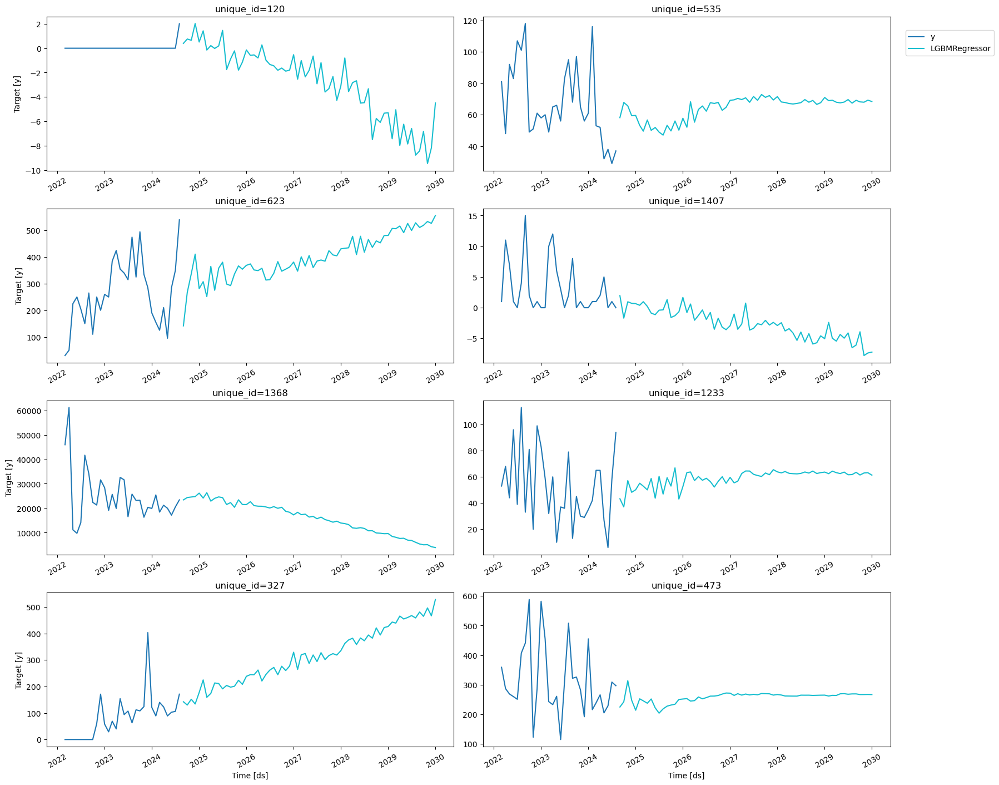

In [356]:
fig = plot_series(Y_train_df, preds)
fig

In [ ]:
###

In [161]:
 evaluate_cv(cv_result2).mean()

LGBMRegressor    15293.913861
dtype: float64

In [838]:
from mlforecast.lgb_cv import LightGBMCV

In [918]:
cv = LightGBMCV(
    freq='MS',
    target_transforms=[Differences([1])],
    lags=[1,3,4,6,12,24],  # Lag features: values from 1, 3, 5, 7, and 12 time steps ago
    lag_transforms={
        1: [ExpandingMean(),
            RollingStd(window_size=3),
            RollingMean(window_size=3),
            RollingMin(window_size=3),
            RollingMax(window_size=3),
            RollingQuantile(p=0.5, window_size=3),
            ExponentiallyWeightedMean(alpha=0.5),
           ExponentiallyWeightedMean(alpha=0.3)],
        6:[  # Transformations applied to lag 6
            RollingMean(window_size=6),  # Rolling mean with a window of 6 time steps
            RollingStd(window_size=6),  # Rolling standard deviation with a window of 6 time steps
            RollingMin(window_size=6),  # Rolling minimum with a window of 6 time steps
            RollingMax(window_size=6),  # Rolling maximum with a window of 6 time steps
            RollingQuantile(p=0.5, window_size=6),
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3)],
        
        12: [ExpandingMean(),
             RollingStd(window_size=6),
             RollingMean(window_size=6),
             RollingMin(window_size=6),
            RollingMax(window_size=6),
             RollingQuantile(p=0.5, window_size=6),
             ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3)]
    },
    date_features=['year', 'month', 'quarter'],  # Extract year, month, and quarter from the date as features
)

cv_hist = cv.fit(
    df_n_filtered,
    n_windows=1,
    h=6,
    params=lgb_params,
    eval_every=5,
    early_stopping_evals=5,    
    compute_cv_preds=True,
)

[5] mape: inf
[10] mape: inf
[15] mape: inf
[20] mape: inf
[25] mape: inf
[30] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[35] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[40] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[45] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[50] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[55] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[60] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[65] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[70] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[75] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[80] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[85] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[90] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[95] mape: inf


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


[100] mape: inf
Using best iteration: 100


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\lgb_cv.py:335: RuntimeWarning: invalid value encountered in scalar divide
  improvement_pct = 1 - hist[-1][1] / hist[-(early_stopping_evals + 1)][1]


In [919]:
cv.cv_preds_

,unique_id,ds,y,Booster,window
0,1685,2024-09-01,420.0,146.384092,0
1,1685,2024-10-01,504.0,212.692235,0
2,1685,2024-11-01,300.0,235.277753,0
3,1685,2024-12-01,264.0,222.687796,0
4,1685,2025-01-01,264.0,293.021536,0
...,...,...,...,...,...
7771,16,2024-10-01,1200.0,1041.499159,0
7772,16,2024-11-01,1205.0,920.137190,0
7773,16,2024-12-01,1165.0,1050.039404,0
7774,16,2025-01-01,1010.0,1030.549709,0


In [920]:
fig = plot_series(forecasts_df=cv.cv_preds_.drop(columns='window'))

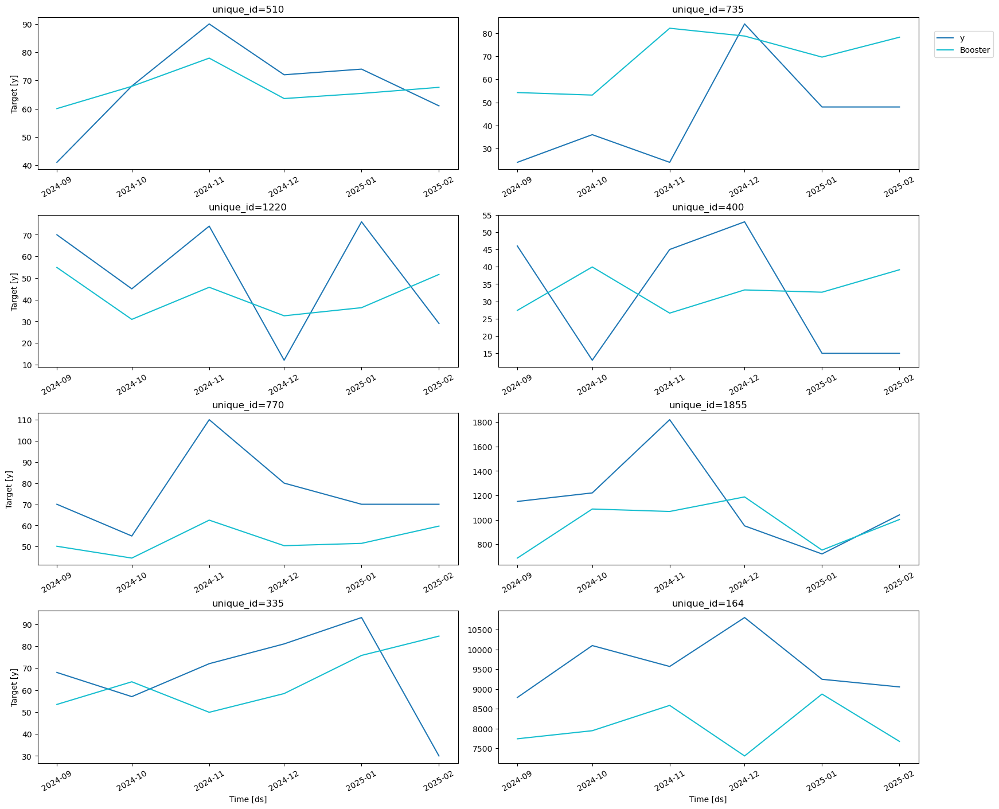

In [921]:
fig

In [922]:
final_fcst = MLForecast.from_cv(cv)
final_fcst.fit(Y_train_df)
preds = final_fcst.predict(65,level=[80, 90, 95])


C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\forecast.py:752: UserWarning: Please rerun the `fit` method passing a proper value to prediction intervals to compute them.
  warnings.warn(warn_msg, UserWarning)


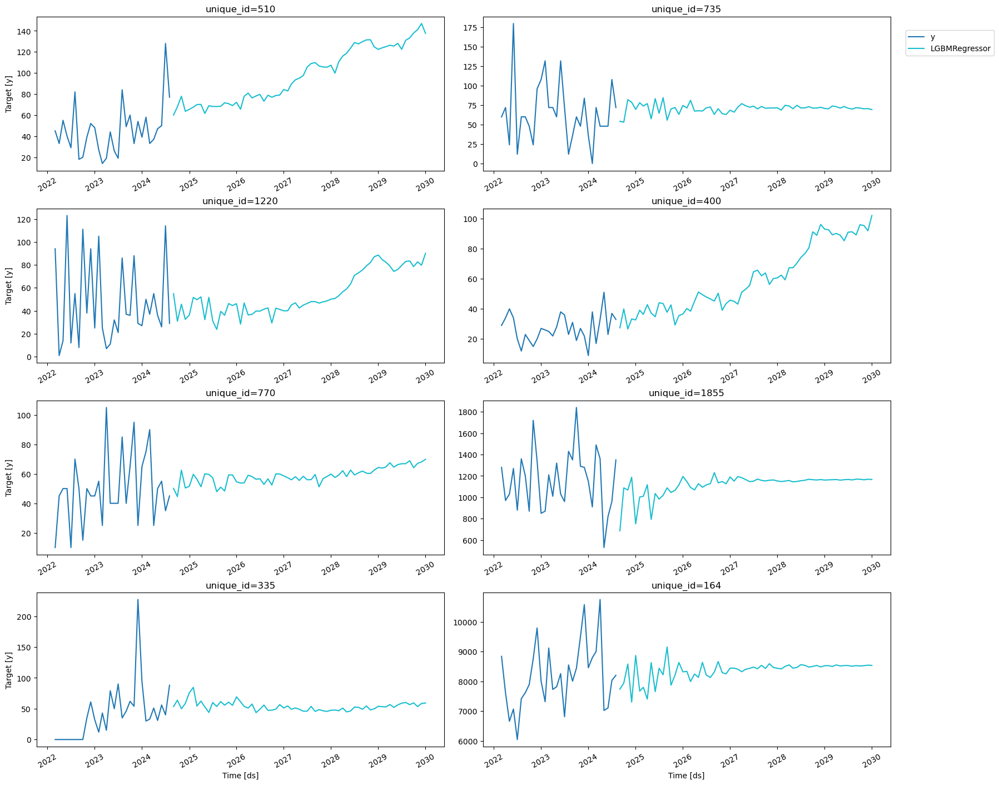

In [924]:
fig = plot_series(Y_train_df, preds)
fig

## New Approach 

In [260]:
from mlforecast.auto import (
    AutoLightGBM,
    AutoMLForecast,
    AutoModel,
    AutoRidge,
    ridge_space,
)

import optuna

In [237]:
df_n.head()

,unique_id,ds,y
2,1685,2022-03-01,1002.0
3,1685,2022-04-01,918.0
4,1685,2022-05-01,1194.0
5,1685,2022-06-01,984.0
6,1685,2022-07-01,660.0


In [416]:
optuna.logging.set_verbosity(optuna.logging.ERROR)
auto_mlf = AutoMLForecast(
    models={'lgb': AutoLightGBM(), 'ridge': AutoRidge()},
    freq='MS',
    season_length=12,
    
)
auto_mlf.fit(
    Y_train_df,
    n_windows=2,
    h=6,
    num_samples=2,  # number of trials to run
)

AutoMLForecast(models={'lgb': AutoModel(model=LGBMRegressor), 'ridge': AutoModel(model=Ridge)})

In [417]:
Y_test_df[Y_test_df['unique_id']==0].head(10)

,unique_id,ds,y
66103,0,2024-09-01,168.0
66104,0,2024-10-01,96.0
66105,0,2024-11-01,252.0
66106,0,2024-12-01,432.0
66107,0,2025-01-01,276.0
66108,0,2025-02-01,120.0


In [418]:
preds = auto_mlf.predict(6)
preds.head(9)

,unique_id,ds,lgb,ridge
0,0,2024-09-01,175.118636,245.423667
1,0,2024-10-01,130.533992,243.720394
2,0,2024-11-01,146.080633,267.076801
3,0,2024-12-01,162.365155,276.769049
4,0,2025-01-01,152.428326,238.665341
5,0,2025-02-01,142.491497,235.672436
6,1,2024-09-01,948.920415,1081.602700
7,1,2024-10-01,859.499220,1121.232753
8,1,2024-11-01,864.163514,1143.478828


In [419]:
merged_df = pd.merge(preds, Y_test_df, on=['unique_id', 'ds'], how='inner')

In [420]:
merged_df.head()

,unique_id,ds,lgb,ridge,y
0,0,2024-09-01,175.118636,245.423667,168.0
1,0,2024-10-01,130.533992,243.720394,96.0
2,0,2024-11-01,146.080633,267.076801,252.0
3,0,2024-12-01,162.365155,276.769049,432.0
4,0,2025-01-01,152.428326,238.665341,276.0


In [421]:
# Function to calculate SMAPE
def smape(y_true, y_pred):
    return np.mean(2 * np.abs(y_true - y_pred) / (np.abs(y_true) + np.abs(y_pred))) * 100

# Function to calculate MASE
def mase(y_true, y_pred):
    naive_forecast = np.abs(np.diff(y_true)).mean()  # Naïve one-step forecast MAE
    return np.mean(np.abs(y_true - y_pred)) / naive_forecast

# Compute metrics for each model
metrics = {}
for model in ["lgb", "ridge"]:
    metrics[model] = {
        "SMAPE": smape(merged_df["y"], merged_df[model]),
        "MASE": mase(merged_df["y"], merged_df[model])
    }

# Compute OWA (assuming naive model has SMAPE = 18.78 and MASE = 1.29)
smape_naive, mase_naive = 18.78, 1.29
for model in ["lgb", "ridge"]:
    metrics[model]["OWA"] = (metrics[model]["SMAPE"] / smape_naive) + (metrics[model]["MASE"] / mase_naive)

# Convert results to a DataFrame
results_df = pd.DataFrame(metrics).T
print(results_df)

           SMAPE      MASE       OWA
lgb    67.200988  0.381999  3.874450
ridge  82.854135  0.603885  4.879956


In [422]:
import numpy as np
import pandas as pd

def evaluate(preds, Y_test_df, actual_col="y", model_cols=["lgb", "ridge"], smape_naive=18.78, mase_naive=1.29):
    """
    Merge predictions with actual values and evaluate forecast accuracy using SMAPE, MASE, and OWA.

    Parameters:
    - preds: DataFrame containing forecasted values.
    - Y_test_df: DataFrame containing actual values.
    - actual_col: Column name for actual values (default: "y").
    - model_cols: List of model prediction column names.
    - smape_naive: SMAPE of the naive forecast (default: 18.78).
    - mase_naive: MASE of the naive forecast (default: 1.29).

    Returns:
    - DataFrame with SMAPE, MASE, and OWA for each model.
    """
    # Merge predictions with actual values
    merged_df = pd.merge(preds, Y_test_df, on=['unique_id', 'ds'], how='inner')

    def smape(y_true, y_pred):
        return np.mean(2 * np.abs(y_true - y_pred) / (np.abs(y_true) + np.abs(y_pred))) * 100

    def mase(y_true, y_pred):
        naive_forecast = np.abs(np.diff(y_true)).mean()  # Naïve one-step MAE
        return np.mean(np.abs(y_true - y_pred)) / naive_forecast

    metrics = {}
    for model in model_cols:
        smape_val = smape(merged_df[actual_col], merged_df[model])
        mase_val = mase(merged_df[actual_col], merged_df[model])
        owa_val = (smape_val / smape_naive) + (mase_val / mase_naive)

        metrics[model] = {"SMAPE": smape_val, "MASE": mase_val, "OWA": owa_val}

    return pd.DataFrame(metrics).T


In [423]:
evaluate(preds,Y_test_df)

,SMAPE,MASE,OWA
lgb,67.200988,0.381999,3.874450
ridge,82.854135,0.603885,4.879956


In [424]:
lgb.LGBMRegressor

lightgbm.sklearn.LGBMRegressor

In [448]:
def my_lgb_config(trial: optuna.Trial):
    return {
        'learning_rate':  trial.suggest_float("learning_rate", 1e-3, 0.1, log=True),
        'verbosity': -1,
        "bagging_freq": 1,
        #"colsample_bytree": trial.suggest_float("colsample_bytree", 0.05, 1.0),
        'num_leaves': trial.suggest_int('num_leaves', 2, 128, log=True),
        'objective': trial.suggest_categorical('objective', ['l1', 'l2', 'mape']),
    }

my_lgb = AutoModel(
    model=lgb.LGBMRegressor(objective="poisson"),
    config=my_lgb_config,
)
auto_mlf = AutoMLForecast(
    models={'my_lgb': my_lgb},
    freq='MS',
    season_length=12,
).fit(
    Y_train_df,
    n_windows=2,
    h=6,
    num_samples=2,
)
preds = auto_mlf.predict(6)
#evaluate(preds, Y_test_df)

In [449]:
preds.head(10)

,unique_id,ds,my_lgb
0,0,2024-09-01,72.046056
1,0,2024-10-01,72.499805
2,0,2024-11-01,72.956373
3,0,2024-12-01,73.415776
4,0,2025-01-01,73.878034
5,0,2025-02-01,74.343163
6,1,2024-09-01,633.886122
7,1,2024-10-01,629.576025
8,1,2024-11-01,625.295188
9,1,2024-12-01,621.043413


In [509]:
import numpy as np
import pandas as pd

def evaluate(preds, Y_test_df, actual_col="y", model_cols=["my_lgb"], smape_naive=18.78, mase_naive=1.29):
    """
    Merge predictions with actual values and evaluate forecast accuracy using SMAPE, MASE, and OWA.

    Parameters:
    - preds: DataFrame containing forecasted values.
    - Y_test_df: DataFrame containing actual values.
    - actual_col: Column name for actual values (default: "y").
    - model_cols: List of model prediction column names.
    - smape_naive: SMAPE of the naive forecast (default: 18.78).
    - mase_naive: MASE of the naive forecast (default: 1.29).

    Returns:
    - DataFrame with SMAPE, MASE, and OWA for each model.
    """
    # Merge predictions with actual values
    merged_df = pd.merge(preds, Y_test_df, on=['unique_id', 'ds'], how='inner')

    def smape(y_true, y_pred):
        return np.mean(2 * np.abs(y_true - y_pred) / (np.abs(y_true) + np.abs(y_pred))) * 100

    def mase(y_true, y_pred):
        naive_forecast = np.abs(np.diff(y_true)).mean()  # Naïve one-step MAE
        return np.mean(np.abs(y_true - y_pred)) / naive_forecast

    metrics = {}
    for model in model_cols:
        smape_val = smape(merged_df[actual_col], merged_df[model])
        mase_val = mase(merged_df[actual_col], merged_df[model])
        owa_val = (smape_val / smape_naive) + (mase_val / mase_naive)

        metrics[model] = {"SMAPE": smape_val, "MASE": mase_val, "OWA": owa_val}

    return pd.DataFrame(metrics).T


In [510]:
evaluate(preds, Y_test_df)

KeyError: 'my_lgb'

In [452]:
preds= auto_mlf.predict(65)

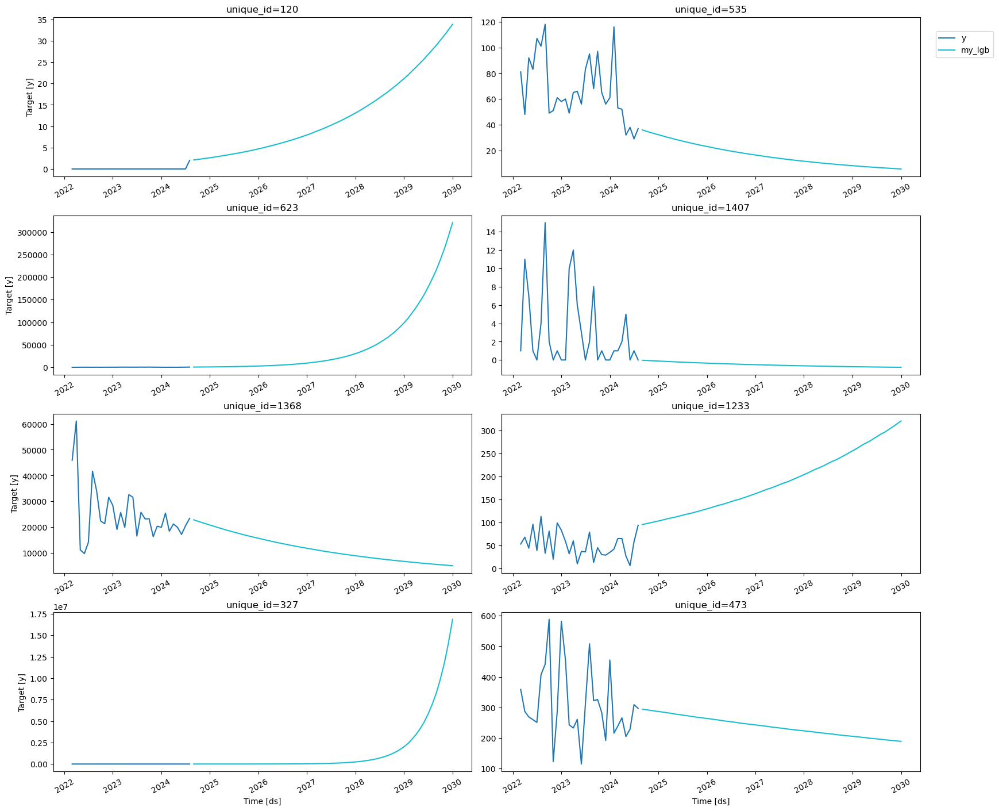

In [453]:
plot_series(Y_train_df,preds)

In [407]:
auto_mlf.results_['AutoLightGBM'].best_trial.user_attrs['config']

KeyError: 'AutoLightGBM'

## new approach 

In [930]:
import lightgbm as lgb
from sklearn.metrics import mean_squared_error
import optuna
from sklearn.metrics import mean_absolute_percentage_error
from statsforecast.models import MSTL

In [931]:
def objective(trial):
    params = {
        "objective": "regression",
        "metric": "rmse",
        "n_estimators": trial.suggest_int("n_estimators",100, 1000),
        "max_depth": trial.suggest_int("max_depth",1,10),
        "verbosity": -1,
        "bagging_freq": 1,
        "learning_rate": trial.suggest_float("learning_rate", 1e-3, 0.1, log=True),
        'lambda_l1': trial.suggest_float('lambda_l1',1e-3, 0.1),
        'lambda_l2': trial.suggest_float('lambda_l2',1e-3, 0.1),
        "num_leaves": trial.suggest_int("num_leaves", 2, 2**10),
        "subsample": trial.suggest_float("subsample", 0.05, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.05, 1.0),
        #"bagging_fraction"  : trial.suggest_uniform('bagging_fraction', 0.1, 1.0),
        "colsample_bytree" : trial.suggest_uniform('colsample_bytree', 0.1, 1.0),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 1, 100),
    
    }

    fcst = MLForecast(
    models = lgb.LGBMRegressor(**params),  # List of models to be used for forecasting
    freq='MS',
    target_transforms=[Differences([1]),MSTL(season_length=[12, 6])],
    lags=[1,2,3,4,6,12,18,24],  # Lag features: values from 1, 3, 5, 7, and 12 time steps ago
    lag_transforms={
        1: [ExpandingMean(),
            RollingStd(window_size=3),
            RollingMean(window_size=3),
            RollingMin(window_size=3),
            RollingMax(window_size=3),
            RollingQuantile(p=0.5, window_size=3),
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3)],
        
        3: [ExpandingMean(),
            RollingStd(window_size=3),
            RollingMean(window_size=3),
            RollingMin(window_size=3),
            RollingMax(window_size=3),
            RollingQuantile(p=0.5, window_size=3),
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3)],
        
        6:[RollingMean(window_size=6),  # Rolling mean with a window of 6 time steps
           RollingStd(window_size=6),  # Rolling standard deviation with a window of 6 time steps
           RollingMin(window_size=6),  # Rolling minimum with a window of 6 time steps
           RollingMax(window_size=6),  # Rolling maximum with a window of 6 time steps
           RollingQuantile(p=0.5, window_size=6),
           ExponentiallyWeightedMean(alpha=0.5),
           ExponentiallyWeightedMean(alpha=0.3)],
        
        12: [#ExpandingMean(),
             RollingStd(window_size=6),
             RollingMean(window_size=6),
             RollingMin(window_size=6),
             RollingMax(window_size=6),
             RollingQuantile(p=0.5, window_size=6),
             ExponentiallyWeightedMean(alpha=0.5),
             ExponentiallyWeightedMean(alpha=0.3)]
    },
    date_features=['year', 'month', 'quarter'],  # Extract year, month, and quarter from the date as features) 
    )
    fcst.fit(Y_train_df)
    p = fcst.predict(6)
    
    p = p.merge(Y_test_df[['unique_id', 'ds', 'y']], on=['unique_id', 'ds'], how='left')
    error = mean_absolute_percentage_error(p['y'], p['LGBMRegressor'])
    return error

In [932]:
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=20)

C:\Users\hupadhya1\AppData\Local\Temp\ipykernel_13768\743062199.py:16: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  "colsample_bytree" : trial.suggest_uniform('colsample_bytree', 0.1, 1.0),
C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\optuna\trial\_trial.py:678: RuntimeWarning: Inconsistent parameter values for distribution with name "colsample_bytree"! This might be a configuration mistake. Optuna allows to call the same distribution with the same name more than once in a trial. When the parameter values are inconsistent optuna only uses the values of the first call and ignores all following. Using these values: {'step': None, 'low': 0.05, 'high': 1.0, 'log': False}
  warnings.warn(


AttributeError: 'MSTL' object has no attribute 'set_column_names'

In [927]:
study.best_params

{'n_estimators': 924,
 'max_depth': 6,
 'learning_rate': 0.09828846089775327,
 'lambda_l1': 0.02652035210811373,
 'lambda_l2': 0.05621842518320813,
 'num_leaves': 273,
 'subsample': 0.24736437096833347,
 'colsample_bytree': 0.10350731188845352,
 'min_data_in_leaf': 24}

In [928]:
study.best_value

2.58669672462728e+17

In [902]:
params ={'learning_rate': 0.07083778150205216,
         #'max_depth': 4,
         'lambda_l1': 0.001,
         'lambda_l2': 0.045,
         'num_leaves': 500,
         'subsample': 0.7950532210627119,
         'colsample_bytree': 0.4427756356956215,
         'min_data_in_leaf': 30,
         'verbosity':-1,
         'n_jobs':-1}


In [1057]:
fcst = MLForecast(
    models= LGBMRegressor(**params),
    #lgb.LGBMRegressor(verbosity=-1),  # LightGBM regressor with verbosity turned off
    #XGBRegressor(),  # XGBoost regressor with default parameters
    #RandomForestRegressor(random_state=0)],
    freq='MS',
    target_transforms=[Differences([1])],
    lags=[1,2,3,4,6,7,8,12,18,24],  # Lag features: values from 1, 3, 5, 7, and 12 time steps ago
    lag_transforms={
        1: [  # Transformations applied to lag 1
            RollingMean(window_size=3),  # Rolling mean with a window of 3 time steps
            RollingStd(window_size=3),  # Rolling standard deviation with a window of 3 time steps
            RollingMin(window_size=3),  # Rolling minimum with a window of 3 time steps
            RollingMax(window_size=3),  # Rolling maximum with a window of 3 time steps
            RollingQuantile(p=0.5, window_size=3),  # Rolling median (50th percentile) with a window of 3 time steps
            ExpandingMean(),  # Expanding mean (mean of all previous values)
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=1)
        ],
        6:[  # Transformations applied to lag 6
            RollingMean(window_size=6),  # Rolling mean with a window of 6 time steps
            RollingStd(window_size=6),  # Rolling standard deviation with a window of 6 time steps
            RollingMin(window_size=6),  # Rolling minimum with a window of 6 time steps
            RollingMax(window_size=6),  # Rolling maximum with a window of 6 time steps
            RollingQuantile(p=0.5, window_size=6),  # Rolling median (50th percentile) with a window of 6 time steps
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=6)
        ],
        12: [  # Transformations applied to lag 12 (likely for yearly seasonality)
            RollingMean( window_size=12),  # Seasonal rolling mean with 12-month seasonality and 3-month window
            RollingStd(window_size=12),  # Seasonal rolling standard deviation with 12-month seasonality and 3-month window
            RollingMin(window_size=12),  # Seasonal rolling minimum with 12-month seasonality and 3-month window
            RollingMax(window_size=12),  # Seasonal rolling maximum with 12-month seasonality and 3-month window
            RollingQuantile(p=0.5,window_size=12),  # Seasonal rolling median with 12-month seasonality and 3-month window
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=3)
        ]
    },
    date_features=['year', 'month', 'quarter'],  # Extract year, month, and quarter from the date as features
)
horizon =6
cv_result3 = fcst.cross_validation(
    df_n,
    n_windows=1,  # number of models to train/splits to perform
    h=6,  # length of the validation set in each window
)
cv_result3

,unique_id,ds,cutoff,y,LGBMRegressor
0,0,2024-09-01,2024-08-01,168.0,30.560974
1,0,2024-10-01,2024-08-01,96.0,115.896497
2,0,2024-11-01,2024-08-01,252.0,115.591651
3,0,2024-12-01,2024-08-01,432.0,147.350293
4,0,2025-01-01,2024-08-01,276.0,141.944450
...,...,...,...,...,...
11155,1859,2024-10-01,2024-08-01,100.0,422.632693
11156,1859,2024-11-01,2024-08-01,130.0,441.299728
11157,1859,2024-12-01,2024-08-01,570.0,488.253820
11158,1859,2025-01-01,2024-08-01,320.0,542.049002


In [904]:
fcst.preprocess(Y_train_df)

,unique_id,ds,y,lag1,lag2,lag3,lag4,lag6,lag7,lag8,...,rolling_mean_lag12_window_size12,rolling_std_lag12_window_size12,rolling_min_lag12_window_size12,rolling_max_lag12_window_size12,rolling_quantile_lag12_p0.5_window_size12,exponentially_weighted_mean_lag12_alpha0.5,exponentially_weighted_mean_lag12_alpha0.3,year,month,quarter
27,1685,2024-04-01,444.0,120.0,-84.0,-354.0,222.0,-60.0,-54.0,-48.0,...,-7.500000,267.816932,-402.0,444.0,45.0,-0.688477,-20.298617,2024,4,2
28,1685,2024-05-01,-666.0,444.0,120.0,-84.0,-354.0,12.0,-60.0,-54.0,...,-26.500000,253.585381,-402.0,444.0,39.0,23.655762,0.190968,2024,5,2
29,1685,2024-06-01,252.0,-666.0,444.0,120.0,-84.0,222.0,12.0,-60.0,...,-8.500000,246.955462,-402.0,444.0,39.0,14.827881,1.933678,2024,6,2
30,1685,2024-07-01,-204.0,252.0,-666.0,444.0,120.0,-354.0,222.0,12.0,...,9.000000,229.380985,-402.0,444.0,39.0,-49.586060,-32.846426,2024,7,3
31,1685,2024-08-01,-102.0,-204.0,252.0,-666.0,444.0,-84.0,-354.0,222.0,...,2.500000,229.836503,-402.0,444.0,27.0,-48.793030,-37.392498,2024,8,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151002,16,2024-04-01,360.0,-455.0,295.0,25.0,-65.0,245.0,-245.0,135.0,...,-2.916667,162.207195,-220.0,285.0,-25.0,-86.605225,-45.052486,2024,4,2
151003,16,2024-05-01,-475.0,360.0,-455.0,295.0,25.0,35.0,245.0,-245.0,...,41.666667,208.896814,-220.0,465.0,55.0,189.197388,107.963260,2024,5,2
151004,16,2024-06-01,130.0,-475.0,360.0,-455.0,295.0,-65.0,35.0,245.0,...,1.250000,237.344447,-365.0,465.0,-25.0,-87.901306,-33.925718,2024,6,2
151005,16,2024-07-01,110.0,130.0,-475.0,360.0,-455.0,25.0,-65.0,35.0,...,1.250000,237.344447,-365.0,465.0,-25.0,-76.450653,-43.248003,2024,7,3


In [905]:
def evaluate_cv(df):
    return rmse(df, models=['LGBMRegressor'], id_col='cutoff').set_index('cutoff')

split_rmse = evaluate_cv(cv_result3)
split_rmse

,LGBMRegressor
cutoff,
2024-08-01,14790.607599


In [906]:
fcst.fit(Y_train_df)
preds = final_fcst.predict(6,level=[80, 90, 95])

C:\Users\hupadhya1\AppData\Local\anaconda3\Lib\site-packages\mlforecast\forecast.py:752: UserWarning: Please rerun the `fit` method passing a proper value to prediction intervals to compute them.
  warnings.warn(warn_msg, UserWarning)


In [907]:
preds

,unique_id,ds,LGBMRegressor
0,0,2024-09-01,16.309014
1,0,2024-10-01,150.813125
2,0,2024-11-01,94.859306
3,0,2024-12-01,274.076408
4,0,2025-01-01,96.923416
...,...,...,...
11155,1859,2024-10-01,353.331656
11156,1859,2024-11-01,248.332599
11157,1859,2024-12-01,432.537023
11158,1859,2025-01-01,342.379274


In [908]:
evaluate(Y_test_df,preds)

,SMAPE,MASE,OWA
LGBMRegressor,39.066509,0.45426,2.432358


In [909]:
def custom_round_vectorized(arr):
    arr = np.where(arr < 0, 0, arr)
    decimal_part = arr - np.floor(arr)
    rounded_arr = np.where(decimal_part >= 0.5, np.ceil(arr), np.floor(arr))
    return rounded_arr

In [910]:
preds=fcst.predict(65)

In [911]:
preds['LGBMRegressor'] = custom_round_vectorized(preds['LGBMRegressor'].values)

In [912]:
evaluate(Y_test_df,preds)

,SMAPE,MASE,OWA
LGBMRegressor,36.963688,0.415049,2.289991


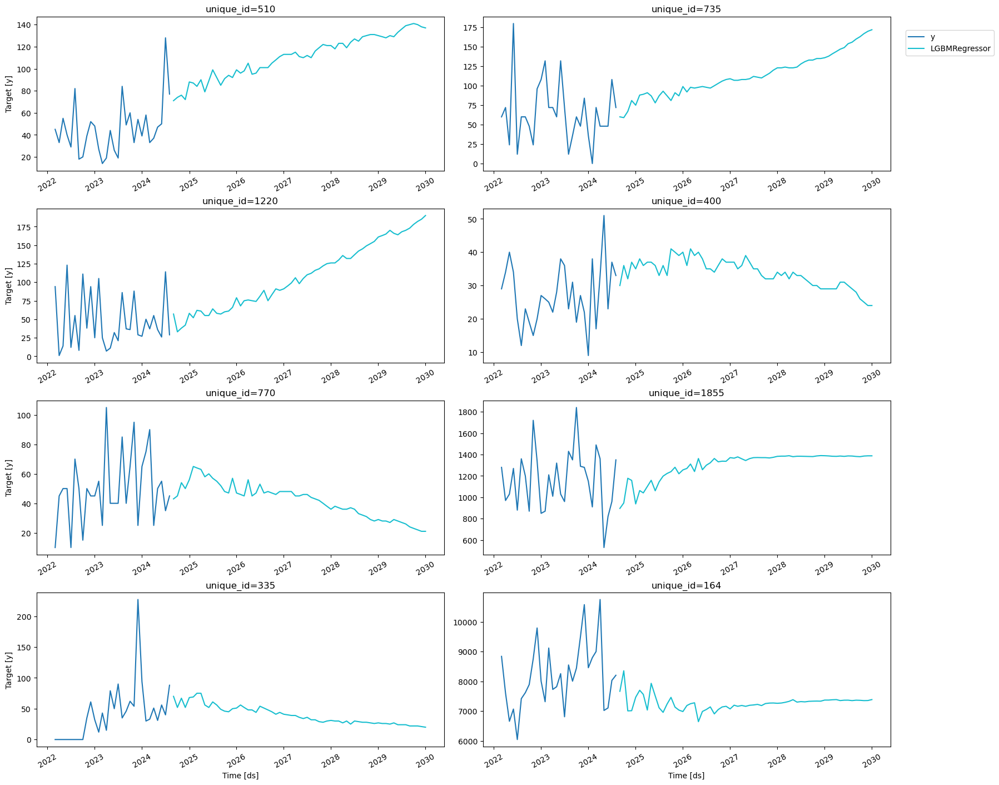

In [913]:
fig = plot_series(Y_train_df, preds)
fig

In [787]:
import numpy as np
import pandas as pd

def evaluate(preds, Y_test_df, actual_col="y", model_cols=["LGBMRegressor"], smape_naive=18.78, mase_naive=1.29):
    """
    Merge predictions with actual values and evaluate forecast accuracy using SMAPE, MASE, and OWA.

    Parameters:
    - preds: DataFrame containing forecasted values.
    - Y_test_df: DataFrame containing actual values.
    - actual_col: Column name for actual values (default: "y").
    - model_cols: List of model prediction column names.
    - smape_naive: SMAPE of the naive forecast (default: 18.78).
    - mase_naive: MASE of the naive forecast (default: 1.29).

    Returns:
    - DataFrame with SMAPE, MASE, and OWA for each model.
    """
    # Merge predictions with actual values
    merged_df = pd.merge(preds, Y_test_df, on=['unique_id', 'ds'], how='inner')

    def smape(y_true, y_pred):
        return np.mean(2 * np.abs(y_true - y_pred) / (np.abs(y_true) + np.abs(y_pred))) * 100

    def mase(y_true, y_pred):
        naive_forecast = np.abs(np.diff(y_true)).mean()  # Naïve one-step MAE
        return np.mean(np.abs(y_true - y_pred)) / naive_forecast

    metrics = {}
    for model in model_cols:
        smape_val = smape(merged_df[actual_col], merged_df[model])
        mase_val = mase(merged_df[actual_col], merged_df[model])
        owa_val = (smape_val / smape_naive) + (mase_val / mase_naive)

        metrics[model] = {"SMAPE": smape_val, "MASE": mase_val, "OWA": owa_val}

    return pd.DataFrame(metrics).T


In [647]:
evaluate(preds, Y_test_df)

,SMAPE,MASE,OWA
LGBMRegressor,74.836823,0.407702,4.30097


In [650]:
Y_train_df[Y_train_df['unique_id']==1407]]

,unique_id,ds,y
96804,1407,2022-03-01,1.0
96805,1407,2022-04-01,11.0
96806,1407,2022-05-01,7.0
96807,1407,2022-06-01,1.0
96808,1407,2022-07-01,0.0
96809,1407,2022-08-01,4.0
96810,1407,2022-09-01,15.0
96811,1407,2022-10-01,2.0
96812,1407,2022-11-01,0.0
96813,1407,2022-12-01,1.0


In [653]:
fcst.fit(Y_train_df[Y_train_df['unique_id']==1407])

MLForecast(models=[LGBMRegressor], freq=MS, lag_features=['lag1', 'lag3', 'lag4', 'lag6', 'lag7', 'lag8', 'lag12', 'lag18', 'lag24', 'rolling_mean_lag1_window_size3', 'rolling_std_lag1_window_size3', 'rolling_min_lag1_window_size3', 'rolling_max_lag1_window_size3', 'rolling_quantile_lag1_p0.5_window_size3', 'expanding_mean_lag1', 'exponentially_weighted_mean_lag1_alpha0.5', 'exponentially_weighted_mean_lag1_alpha0.3', 'rolling_mean_lag6_window_size6', 'rolling_std_lag6_window_size6', 'rolling_min_lag6_window_size6', 'rolling_max_lag6_window_size6', 'rolling_quantile_lag6_p0.5_window_size6', 'exponentially_weighted_mean_lag6_alpha0.5', 'exponentially_weighted_mean_lag6_alpha0.3', 'rolling_mean_lag12_window_size12', 'rolling_std_lag12_window_size12', 'rolling_min_lag12_window_size12', 'rolling_max_lag12_window_size12', 'rolling_quantile_lag12_p0.5_window_size12', 'exponentially_weighted_mean_lag12_alpha0.5', 'exponentially_weighted_mean_lag12_alpha0.3'], date_features=['year', 'month', '

In [659]:
?fcst.predict

Signature:
fcst.predict(
    h: int,
    before_predict_callback: Optional[Callable] = None,
    after_predict_callback: Optional[Callable] = None,
    new_df: Optional[~DFType] = None,
    level: Optional[List[Union[int, float]]] = None,
    X_df: Optional[~DFType] = None,
    ids: Optional[List[str]] = None,
) -> ~DFType
Docstring:
Compute the predictions for the next `h` steps.

Parameters
----------
h : int
    Number of periods to predict.
before_predict_callback : callable, optional (default=None)
    Function to call on the features before computing the predictions.
        This function will take the input dataframe that will be passed to the model for predicting and should return a dataframe with the same structure.
        The series identifier is on the index.
after_predict_callback : callable, optional (default=None)
    Function to call on the predictions before updating the targets.
        This function will take a pandas Series with the predictions and should return ano

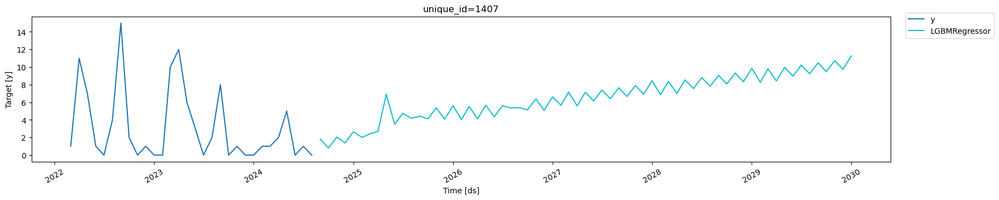

In [671]:
plot_series(Y_train_df[Y_train_df['unique_id']==1407], pred)

In [670]:
pred=fcst.predict(new_df=Y_train_df[Y_train_df['unique_id']==1407],h=65 )

## Voting regressor method 

In [982]:
import polars as pl
import pandas as pd
from xgboost import XGBRegressor, XGBRFRegressor, plot_importance
import lightgbm as lgb
from datetime import datetime
from dateutil.relativedelta import relativedelta
from sklearn.ensemble import VotingRegressor
import pickle
import math
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default = "plotly_white"

today= datetime.now()

In [987]:
df=pd.read_csv(r"C:\Users\hupadhya1\Documents\ML_DEMANATRA_Int\CMF_END_MED_Lon Run.csv")

In [989]:
df["Month"]= pd.to_datetime(df["Month"])

In [ ]:
min_threshold, max_threshold = 12, 36

# Get unique_id values to drop based on trailing_zero_sales
uids_trailing = (
    trailing_zero_sales.query(f"{min_threshold} < trailing_zero_sales < {max_threshold}")
                       .index
                       .to_list()
)

# Get unique_id values to drop based on leading_zero_sales
_threshold = 12
uids_leading = (
    leading_zero_sales.query(f"leading_zero_sales > {_threshold}")
                      .index
                      .to_list()
)

# Combine both lists
uids_to_drop = set(uids_trailing + uids_leading)

# Drop them from df_n
df_n_filtered = df[~df["unique_id"].isin(uids_to_drop)]


In [1001]:
df_n

,unique_id,Month,Act Orders Final Rev
2,1685,2022-03-01,1002.0
3,1685,2022-04-01,918.0
4,1685,2022-05-01,1194.0
5,1685,2022-06-01,984.0
6,1685,2022-07-01,660.0
...,...,...,...
151084,17,2024-10-01,0.0
151085,17,2024-11-01,0.0
151086,17,2024-12-01,0.0
151087,17,2025-01-01,0.0


In [1002]:
#df=df_n[['Item','Month','Act Orders Final Rev']]
df1=df_n[df_n['Month']<today-relativedelta(months=1)]

In [1061]:
df_n

,unique_id,ds,y
2,1685,2022-03-01,1002.0
3,1685,2022-04-01,918.0
4,1685,2022-05-01,1194.0
5,1685,2022-06-01,984.0
6,1685,2022-07-01,660.0
...,...,...,...
151084,17,2024-10-01,0.0
151085,17,2024-11-01,0.0
151086,17,2024-12-01,0.0
151087,17,2025-01-01,0.0


In [1073]:
cc=df_n_filtered.groupby('unique_id').sum(numeric_only=True)['y'].sort_values(ascending=False).reset_index()

In [1079]:
fdf=df_n_filtered[df_n_filtered['unique_id'].isin(cc['unique_id'][:20])]
#fdf=fdf.rename(columns={'Month':'ds','unique_id':'unique_id','Act Orders Final Rev':'y'})
fdf=fdf[['ds','unique_id','y']]
fdf=fdf.groupby(['unique_id','ds']).sum().reset_index()
pdf=fdf[fdf['ds']<today-relativedelta(months=6)]
fcst = MLForecast(
    models=[XGBRFRegressor(),XGBRegressor()],
    freq='MS',
    target_transforms=[Differences([1])],
    lags=[1,2,3,4,6,7,8,12,18,24],  # Lag features: values from 1, 3, 5, 7, and 12 time steps ago
    lag_transforms={
        1: [  # Transformations applied to lag 1
            RollingMean(window_size=3),  # Rolling mean with a window of 3 time steps
            RollingStd(window_size=3),  # Rolling standard deviation with a window of 3 time steps
            RollingMin(window_size=3),  # Rolling minimum with a window of 3 time steps
            RollingMax(window_size=3),  # Rolling maximum with a window of 3 time steps
            RollingQuantile(p=0.5, window_size=3),  # Rolling median (50th percentile) with a window of 3 time steps
            ExpandingMean(),  # Expanding mean (mean of all previous values)
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=1)
        ],
        6:[  # Transformations applied to lag 6
            RollingMean(window_size=6),  # Rolling mean with a window of 6 time steps
            RollingStd(window_size=6),  # Rolling standard deviation with a window of 6 time steps
            RollingMin(window_size=6),  # Rolling minimum with a window of 6 time steps
            RollingMax(window_size=6),  # Rolling maximum with a window of 6 time steps
            RollingQuantile(p=0.5, window_size=6),  # Rolling median (50th percentile) with a window of 6 time steps
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=6)
        ],
        12: [  # Transformations applied to lag 12 (likely for yearly seasonality)
            RollingMean( window_size=12),  # Seasonal rolling mean with 12-month seasonality and 3-month window
            RollingStd(window_size=12),  # Seasonal rolling standard deviation with 12-month seasonality and 3-month window
            RollingMin(window_size=12),  # Seasonal rolling minimum with 12-month seasonality and 3-month window
            RollingMax(window_size=12),  # Seasonal rolling maximum with 12-month seasonality and 3-month window
            RollingQuantile(p=0.5,window_size=12),  # Seasonal rolling median with 12-month seasonality and 3-month window
            ExponentiallyWeightedMean(alpha=0.5),
            ExponentiallyWeightedMean(alpha=0.3),
            #SeasonalRollingMean(season_length=12,window_size=3)
        ]
    },
    date_features=['year', 'month', 'quarter'],)
fcst.fit(pdf.fillna(0))
preds=fcst.predict(60)

In [1080]:
fcst.preprocess(fdf)

,unique_id,ds,y,lag1,lag2,lag3,lag4,lag6,lag7,lag8,...,rolling_mean_lag12_window_size12,rolling_std_lag12_window_size12,rolling_min_lag12_window_size12,rolling_max_lag12_window_size12,rolling_quantile_lag12_p0.5_window_size12,exponentially_weighted_mean_lag12_alpha0.5,exponentially_weighted_mean_lag12_alpha0.3,year,month,quarter
25,1028,2024-04-01,79480.0,22520.0,-105000.0,-11080.0,131280.0,12720.0,-35040.0,247240.0,...,10456.666667,65343.826770,-102680.0,91240.0,34480.0,-32195.429688,-14881.050773,2024,4,2
26,1028,2024-05-01,-64320.0,79480.0,22520.0,-105000.0,-11080.0,-62080.0,12720.0,-35040.0,...,21400.000000,77881.941424,-102680.0,156800.0,45100.0,62302.285156,36623.264459,2024,5,2
27,1028,2024-06-01,62080.0,-64320.0,79480.0,22520.0,-105000.0,131280.0,-62080.0,12720.0,...,20700.000000,77671.141710,-102680.0,156800.0,40900.0,50311.142578,37132.285121,2024,6,2
28,1028,2024-07-01,19240.0,62080.0,-64320.0,79480.0,22520.0,-11080.0,131280.0,-62080.0,...,2200.000000,106202.015389,-229520.0,156800.0,40900.0,-89604.428711,-42863.400415,2024,7,3
29,1028,2024-08-01,-43800.0,19240.0,62080.0,-64320.0,79480.0,-105000.0,-11080.0,131280.0,...,16333.333333,126499.710193,-229520.0,247240.0,40900.0,78817.785645,44167.619709,2024,8,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,1746,2024-10-01,44472.0,71400.0,-34872.0,8712.0,119664.0,-132120.0,121320.0,-7656.0,...,4058.000000,48735.890781,-38472.0,108912.0,-11100.0,43918.039581,23753.840506,2024,10,4
716,1746,2024-11-01,-102792.0,44472.0,71400.0,-34872.0,8712.0,-52344.0,-132120.0,121320.0,...,-480.000000,52280.967926,-61608.0,108912.0,-14088.0,-8844.980209,-1854.711645,2024,11,4
717,1746,2024-12-01,36744.0,-102792.0,44472.0,71400.0,-34872.0,119664.0,-52344.0,-132120.0,...,2284.000000,52251.084053,-61608.0,108912.0,-11100.0,4061.509895,3792.101848,2024,12,4
718,1746,2025-01-01,-17640.0,36744.0,-102792.0,44472.0,71400.0,8712.0,119664.0,-52344.0,...,-1148.000000,54573.786315,-61608.0,108912.0,-17952.0,-24549.245052,-13293.528706,2025,1,1


In [1075]:
fcst.save('models/')

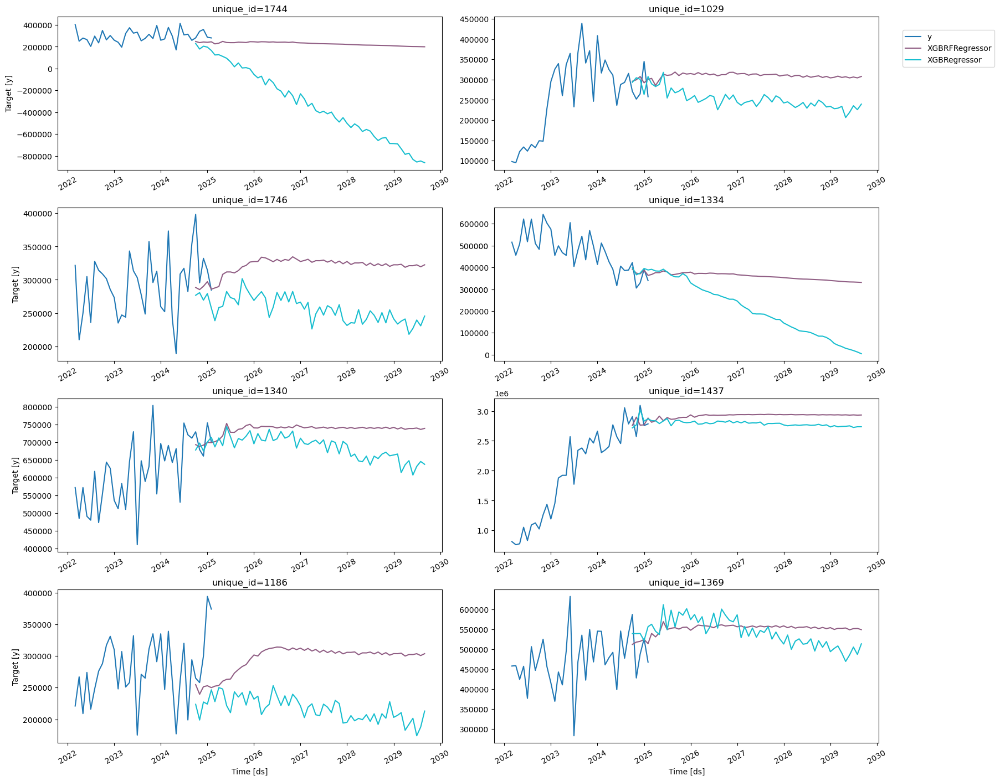

In [1076]:
from utilsforecast.plotting import plot_series
plot_series(fdf, preds)

In [983]:
df=pl.read_csv(r"C:\Users\hupadhya1\Documents\ML_DEMANATRA_Int\CMF_END_MED_Lon Run.csv",infer_schema_length=10000)
df = df.with_columns(pl.col("Month").str.to_datetime("%Y-%m-%d").alias("Month"))

In [1010]:
df_n

,unique_id,Month,Act Orders Final Rev
2,1685,2022-03-01,1002.0
3,1685,2022-04-01,918.0
4,1685,2022-05-01,1194.0
5,1685,2022-06-01,984.0
6,1685,2022-07-01,660.0
...,...,...,...
151084,17,2024-10-01,0.0
151085,17,2024-11-01,0.0
151086,17,2024-12-01,0.0
151087,17,2025-01-01,0.0


In [1008]:
df = pl.from_pandas(df_n)

In [1011]:

df = df.select(["unique_id", "Month", "Act Orders Final Rev"])
df1=df.filter(pl.col('Month')<today-relativedelta(months=1))

In [1013]:
#df=pl.read_csv(r"C:\Users\hupadhya1\Documents\ML_DEMANATRA_Int\CMF_END_MED_Lon Run.csv",infer_schema_length=10000)
#df=df[['Item','Month','Act Orders Rev']]
#df = df.with_columns(pl.col("month").str.to_datetime("%Y-%m-%d").alias("month"))
#df1=df.filter(pl.col('Month')<today-relativedelta(months=1))
df1=df1.group_by(["unique_id",'Month']).sum()
df1=df1.sort('Month',descending=False)
cc=df.group_by("unique_id").sum().sort('Act Orders Final Rev',descending=True)

def preprocess1(df):
    df=df.with_columns(month=pl.col('Month').dt.month())
    df=df.with_columns(days=(pl.col('Month')-datetime(year=2021,month=1,day=1)).dt.total_days())
    return df

def pplot(df,pred,cat):
    pdf=df.filter(pl.col("unique_id")==cat)
    prd=pl.DataFrame({'Month':pl.date_range(today.replace(day=1),today.replace(day=1)+relativedelta(months=len(pred)-1), "1mo",eager=True),'XGBoost':pred})
    pdf=pdf.with_columns(pl.col('Month').cast(pl.Date))
    pdf=pdf.join(prd,on='Month', how="full", coalesce=True)
    pdf=pdf.sort('Month',descending=False)
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=pdf['Month'].to_list(),y=pdf['Act Orders Final Rev'].to_list(),mode='lines',name='Act Orders',text=cat))
    fig.add_trace(go.Scatter(x=pdf['Month'].to_list(),y=pdf['XGBoost'].to_list(),mode='lines',name='XGBoost'))
    return fig

In [1068]:
processed_df.columns

Index(['unique_id', 'ds', 'y', 'lag1', 'lag3', 'lag4', 'lag6', 'lag12',
       'rolling_mean_lag1_window_size3', 'rolling_std_lag1_window_size3',
       'rolling_min_lag1_window_size3', 'rolling_max_lag1_window_size3',
       'rolling_quantile_lag1_p0.5_window_size3', 'expanding_mean_lag1',
       'exponentially_weighted_mean_lag1_alpha0.5',
       'exponentially_weighted_mean_lag1_alpha0.3',
       'rolling_mean_lag6_window_size6', 'rolling_std_lag6_window_size6',
       'rolling_min_lag6_window_size6', 'rolling_max_lag6_window_size6',
       'rolling_quantile_lag6_p0.5_window_size6',
       'exponentially_weighted_mean_lag6_alpha0.5',
       'exponentially_weighted_mean_lag6_alpha0.3',
       'rolling_mean_lag12_window_size12', 'rolling_std_lag12_window_size12',
       'rolling_min_lag12_window_size12', 'rolling_max_lag12_window_size12',
       'rolling_quantile_lag12_p0.5_window_size12',
       'exponentially_weighted_mean_lag12_alpha0.5',
       'exponentially_weighted_mean_lag12_a

In [1072]:
pp=processed_df
for i in cc["unique_id"][:40]:
    p1=pp.filter(pl.col("unique_id")==i).to_pandas()
    mod1=XGBRegressor()
    mod2=XGBRegressor(booster='gblinear')
    #mod2=LGBRegressor(linear_tree= True)
    pipe=VotingRegressor([('xgbm',mod1),('lgbm',mod2)])
    pipe.fit(X=p1[['month','days']],y=p1['y'])
    with open(f'models/{i}.pkl','wb') as f:
        pickle.dump(pipe,f)

TypeError: Index(...) must be called with a collection of some kind, <Expr ['[(col("unique_id")) == (dyn in…'] at 0x242791ECF20> was passed

In [1083]:
fdf=pl.DataFrame({'Month':pl.date_range(today.replace(day=1),today.replace(day=1)+relativedelta(months=60), "1mo",eager=True)})
fp=preprocess1(fdf)
page = []
for i in cc["unique_id"][:30]:
    with open(f'models/{i}.pkl','rb') as f:
        pr=pickle.load(f)
        pred=pr.predict(fp[['month','days']].to_pandas()) # moved in with # closing models # change features  # add only 
        # close models after run 
        # append pred in polars, 
    #page.append(pplot(df1,pred,i))
#rows = math.ceil(len(page) / 2)

# remove plotting 
'''
fig1 = make_subplots(rows=rows, cols=2,subplot_titles=[i for i in cc["unique_id"][:20]])
for i, chart in enumerate(page):
    fig1.add_traces([chart.data[0],chart.data[1]],rows=math.floor((i+2)/2), cols=i%2+1)
fig1.update_layout(height=2900,showlegend=False)
fig1.show()'''

ValueError: feature_names mismatch: ['lag1', 'lag3', 'lag4', 'lag6', 'lag12', 'rolling_mean_lag1_window_size3', 'rolling_std_lag1_window_size3', 'rolling_min_lag1_window_size3', 'rolling_max_lag1_window_size3', 'rolling_quantile_lag1_p0.5_window_size3', 'expanding_mean_lag1', 'exponentially_weighted_mean_lag1_alpha0.5', 'exponentially_weighted_mean_lag1_alpha0.3', 'rolling_mean_lag6_window_size6', 'rolling_std_lag6_window_size6', 'rolling_min_lag6_window_size6', 'rolling_max_lag6_window_size6', 'rolling_quantile_lag6_p0.5_window_size6', 'exponentially_weighted_mean_lag6_alpha0.5', 'exponentially_weighted_mean_lag6_alpha0.3', 'rolling_mean_lag12_window_size12', 'rolling_std_lag12_window_size12', 'rolling_min_lag12_window_size12', 'rolling_max_lag12_window_size12', 'rolling_quantile_lag12_p0.5_window_size12', 'exponentially_weighted_mean_lag12_alpha0.5', 'exponentially_weighted_mean_lag12_alpha0.3', 'year', 'month', 'quarter'] ['month', 'days']
expected exponentially_weighted_mean_lag1_alpha0.5, rolling_quantile_lag12_p0.5_window_size12, exponentially_weighted_mean_lag6_alpha0.5, rolling_mean_lag6_window_size6, rolling_quantile_lag6_p0.5_window_size6, rolling_std_lag12_window_size12, rolling_std_lag1_window_size3, exponentially_weighted_mean_lag6_alpha0.3, rolling_min_lag6_window_size6, lag6, rolling_min_lag1_window_size3, exponentially_weighted_mean_lag12_alpha0.5, rolling_max_lag12_window_size12, rolling_quantile_lag1_p0.5_window_size3, rolling_max_lag1_window_size3, year, quarter, rolling_min_lag12_window_size12, exponentially_weighted_mean_lag12_alpha0.3, lag12, expanding_mean_lag1, lag4, exponentially_weighted_mean_lag1_alpha0.3, lag3, rolling_max_lag6_window_size6, rolling_std_lag6_window_size6, rolling_mean_lag12_window_size12, lag1, rolling_mean_lag1_window_size3 in input data
training data did not have the following fields: days

In [1047]:
processed_df

,unique_id,ds,y,lag1,lag3,lag4,lag6,lag12,rolling_mean_lag1_window_size3,rolling_std_lag1_window_size3,...,rolling_mean_lag12_window_size12,rolling_std_lag12_window_size12,rolling_min_lag12_window_size12,rolling_max_lag12_window_size12,rolling_quantile_lag12_p0.5_window_size12,exponentially_weighted_mean_lag12_alpha0.5,exponentially_weighted_mean_lag12_alpha0.3,year,month,quarter
26,1685,2024-03-01,120.0,-84.0,222.0,12.0,-54.0,90.0,-72.000000,288.187439,...,-19.500000,267.743602,-402.0,444.0,-27.0,-61.376953,-54.712310,2024,3,1
27,1685,2024-04-01,444.0,120.0,-354.0,222.0,-60.0,60.0,-106.000000,237.764589,...,-7.500000,267.816932,-402.0,444.0,45.0,-0.688477,-20.298617,2024,4,2
28,1685,2024-05-01,-666.0,444.0,-84.0,-354.0,12.0,48.0,160.000000,266.263028,...,-26.500000,253.585381,-402.0,444.0,39.0,23.655762,0.190968,2024,5,2
29,1685,2024-06-01,252.0,-666.0,120.0,-84.0,222.0,6.0,-34.000000,570.799439,...,-8.500000,246.955462,-402.0,444.0,39.0,14.827881,1.933678,2024,6,2
30,1685,2024-07-01,-204.0,252.0,444.0,120.0,-354.0,-114.0,10.000000,593.252054,...,9.000000,229.380985,-402.0,444.0,39.0,-49.586060,-32.846426,2024,7,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151002,16,2024-04-01,360.0,-455.0,25.0,-65.0,245.0,-220.0,-45.000000,379.868398,...,-2.916667,162.207195,-220.0,285.0,-25.0,-86.605225,-45.052486,2024,4,2
151003,16,2024-05-01,-475.0,360.0,295.0,25.0,35.0,465.0,66.666667,452.944073,...,41.666667,208.896814,-220.0,465.0,55.0,189.197388,107.963260,2024,5,2
151004,16,2024-06-01,130.0,-475.0,-455.0,295.0,-65.0,-365.0,-190.000000,476.418933,...,1.250000,237.344447,-365.0,465.0,-25.0,-87.901306,-33.925718,2024,6,2
151005,16,2024-07-01,110.0,130.0,360.0,-455.0,25.0,-65.0,5.000000,431.306156,...,1.250000,237.344447,-365.0,465.0,-25.0,-76.450653,-43.248003,2024,7,3


In [1049]:
p1

,unique_id,Month,Act Orders Final Rev,month,days
0,1357,2022-03-01,59840.0,3,424
1,1357,2022-04-01,71852.0,4,455
2,1357,2022-05-01,50380.0,5,485
3,1357,2022-06-01,102608.0,6,516
4,1357,2022-07-01,57288.0,7,546
5,1357,2022-08-01,57816.0,8,577
6,1357,2022-09-01,86504.0,9,608
7,1357,2022-10-01,57200.0,10,638
8,1357,2022-11-01,73304.0,11,669
9,1357,2022-12-01,78628.0,12,699


In [1051]:
processed_df.columns

Index(['unique_id', 'ds', 'y', 'lag1', 'lag3', 'lag4', 'lag6', 'lag12',
       'rolling_mean_lag1_window_size3', 'rolling_std_lag1_window_size3',
       'rolling_min_lag1_window_size3', 'rolling_max_lag1_window_size3',
       'rolling_quantile_lag1_p0.5_window_size3', 'expanding_mean_lag1',
       'exponentially_weighted_mean_lag1_alpha0.5',
       'exponentially_weighted_mean_lag1_alpha0.3',
       'rolling_mean_lag6_window_size6', 'rolling_std_lag6_window_size6',
       'rolling_min_lag6_window_size6', 'rolling_max_lag6_window_size6',
       'rolling_quantile_lag6_p0.5_window_size6',
       'exponentially_weighted_mean_lag6_alpha0.5',
       'exponentially_weighted_mean_lag6_alpha0.3',
       'rolling_mean_lag12_window_size12', 'rolling_std_lag12_window_size12',
       'rolling_min_lag12_window_size12', 'rolling_max_lag12_window_size12',
       'rolling_quantile_lag12_p0.5_window_size12',
       'exponentially_weighted_mean_lag12_alpha0.5',
       'exponentially_weighted_mean_lag12_a

In [1081]:
for i in cc["unique_id"][:40]:
    p1=processed_df[processed_df["unique_id"] == i]
    mod1=XGBRegressor()
    mod2=XGBRegressor(booster='gblinear')
    #mod2=LGBRegressor(linear_tree= True)
    pipe=VotingRegressor([('xgbm',mod1),('lgbm',mod2)])
    pipe.fit(X=p1[['lag1', 'lag3', 'lag4', 'lag6', 'lag12',
       'rolling_mean_lag1_window_size3', 'rolling_std_lag1_window_size3',
       'rolling_min_lag1_window_size3', 'rolling_max_lag1_window_size3',
       'rolling_quantile_lag1_p0.5_window_size3', 'expanding_mean_lag1',
       'exponentially_weighted_mean_lag1_alpha0.5',
       'exponentially_weighted_mean_lag1_alpha0.3',
       'rolling_mean_lag6_window_size6', 'rolling_std_lag6_window_size6',
       'rolling_min_lag6_window_size6', 'rolling_max_lag6_window_size6',
       'rolling_quantile_lag6_p0.5_window_size6',
       'exponentially_weighted_mean_lag6_alpha0.5',
       'exponentially_weighted_mean_lag6_alpha0.3',
       'rolling_mean_lag12_window_size12', 'rolling_std_lag12_window_size12',
       'rolling_min_lag12_window_size12', 'rolling_max_lag12_window_size12',
       'rolling_quantile_lag12_p0.5_window_size12',
       'exponentially_weighted_mean_lag12_alpha0.5',
       'exponentially_weighted_mean_lag12_alpha0.3', 'year', 'month',
       'quarter']],y=p1['y'])
    with open(f'models/{i}.pkl','wb') as f:
        pickle.dump(pipe,f)

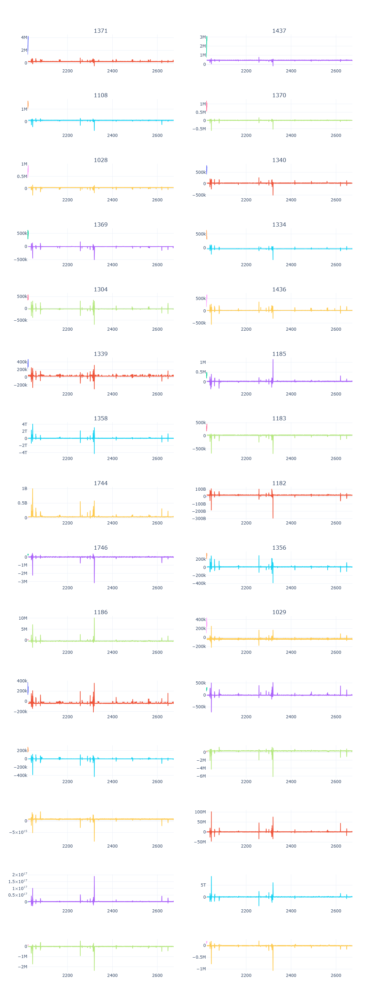

In [1082]:
fdf=pl.DataFrame({'Month':pl.date_range(today.replace(day=1),today.replace(day=1)+relativedelta(months=60), "1mo",eager=True)})
fp=processed_df
page = []
for i in cc["unique_id"][:30]:
    with open(f'models/{i}.pkl','rb') as f:
        pr=pickle.load(f)
    pred=pr.predict(fp[['lag1', 'lag3', 'lag4', 'lag6', 'lag12',
       'rolling_mean_lag1_window_size3', 'rolling_std_lag1_window_size3',
       'rolling_min_lag1_window_size3', 'rolling_max_lag1_window_size3',
       'rolling_quantile_lag1_p0.5_window_size3', 'expanding_mean_lag1',
       'exponentially_weighted_mean_lag1_alpha0.5',
       'exponentially_weighted_mean_lag1_alpha0.3',
       'rolling_mean_lag6_window_size6', 'rolling_std_lag6_window_size6',
       'rolling_min_lag6_window_size6', 'rolling_max_lag6_window_size6',
       'rolling_quantile_lag6_p0.5_window_size6',
       'exponentially_weighted_mean_lag6_alpha0.5',
       'exponentially_weighted_mean_lag6_alpha0.3',
       'rolling_mean_lag12_window_size12', 'rolling_std_lag12_window_size12',
       'rolling_min_lag12_window_size12', 'rolling_max_lag12_window_size12',
       'rolling_quantile_lag12_p0.5_window_size12',
       'exponentially_weighted_mean_lag12_alpha0.5',
       'exponentially_weighted_mean_lag12_alpha0.3', 'year', 'month',
       'quarter']])
    page.append(pplot(df1,pred,i))
rows = math.ceil(len(page) / 2)
fig1 = make_subplots(rows=rows, cols=2,subplot_titles=[i for i in cc["unique_id"][:20]])
for i, chart in enumerate(page):
    fig1.add_traces([chart.data[0],chart.data[1]],rows=math.floor((i+2)/2), cols=i%2+1)
fig1.update_layout(height=2900,showlegend=False)
fig1.show()